# **<h1>GLCM Depth Classifier using GradientBoostingClassifier**



**For training model from scratch:**


1. Download Dependencies
2. Load Dataset from Repo
3. Setup Imports
4. Configure Dataset for Training Setup
5. Initialize Model for Training
6. Post-training Model Evaluation
7. Save Model Weights


**For evaluating Pre-trained model:**


1. Download Dependencies
2. Load Dataset from Repo
3. Setup Imports
4. Model Testing using Pre-Trained Model Weights


# **==================Download Dependencies==================**

In [1]:
!git clone https://github.com/SSSerpenttt/GLCM-Classifier.git

Cloning into 'GLCM-Classifier'...
remote: Enumerating objects: 2013, done.
remote: Counting objects: 100% (128/128), done.
remote: Compressing objects: 100% (82/82), done.
remote: Total 2013 (delta 90), reused 78 (delta 46), pack-reused 1885 (from 3)
Receiving objects: 100% (2013/2013), 131.56 MiB | 44.02 MiB/s, done.
Resolving deltas: 100% (375/375), done.


In [2]:
!pip install -r /content/GLCM-Classifier/requirements.txt

INFO: pip is looking at multiple versions of tensorflow to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of scikit-image to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of jax to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of jax to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 107.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 120.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.9/253.9 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 601.3/601.3 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━

# **==================Load Dataset from Repo==================**

In [1]:
!git clone --branch small https://github.com/SSSerpenttt/GroupEGS-Thesis-Dataset.git

Cloning into 'GroupEGS-Thesis-Dataset'...
remote: Enumerating objects: 2608, done.
remote: Counting objects: 100% (33/33), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 2608 (delta 10), reused 0 (delta 0), pack-reused 2575 (from 1)
Receiving objects: 100% (2608/2608), 213.66 MiB | 21.90 MiB/s, done.
Resolving deltas: 100% (14/14), done.


In [1]:
!git clone https://github.com/SSSerpenttt/GroupEGS-Thesis-Dataset.git

Cloning into 'GroupEGS-Thesis-Dataset'...
remote: Enumerating objects: 2608, done.
remote: Counting objects: 100% (33/33), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 2608 (delta 10), reused 0 (delta 0), pack-reused 2575 (from 1)
Receiving objects: 100% (2608/2608), 213.66 MiB | 67.01 MiB/s, done.
Resolving deltas: 100% (14/14), done.


# **Setup Imports**

In [2]:
import sys
from pathlib import Path

In [3]:
import tensorflow as tf
import numpy as np
import sklearn
import pandas as pd
import matplotlib
import cv2
import scipy

In [4]:
src_path = Path('/content/GLCM-Classifier/src')
if src_path.exists():
    sys.path.append(str(src_path))

from utils.data_loader import load_data
from config import Config
from glcm_model import GLCMModel

# **Configure Dataset for Training Setup**

**Classifier types:**
- xgboost
- randomforest
- lightgbm

In [5]:
# Create a configuration object
config_50epochs = Config(
    epochs=5500,
    data_path="/content/GroupEGS-Thesis-Dataset",  # Colab path
    classifier_type="xgboost"
)

config_25epochs = Config(
    epochs=25,
    data_path="/content/GroupEGS-Thesis-Dataset",  # Colab path
    classifier_type="xgboost"
)

config_20epochs = Config(
    epochs=20,
    data_path="/content/GroupEGS-Thesis-Dataset",
    classifier_type="randomforest"
)

config_15epochs = Config(
    epochs=20,
    data_path="/content/GroupEGS-Thesis-Dataset",  # Colab path
)

config_10epochs = Config(
    epochs=10,
    data_path="/content/GroupEGS-Thesis-Dataset",  # Colab path
)

In [6]:
print(config_50epochs.classifier_type)

xgboost


**Config list:**
- config_25epochs
- config_20epochs
- config_15epochs
- config_10epochs

In [7]:
# Load data
data = load_data(config_50epochs.data_path, include_labels=["depth-deep", "depth-shallow"])

train_data = data["train_data"]
val_data = data["val_data"]
test_data = data["test_data"]
print("Data loaded successfully.")
total_images = len(train_data["images"]) + len(val_data["images"]) + len(test_data["images"])
print(f"Total number of images: {total_images}")

Data loaded successfully.
Total number of images: 1440


In [ ]:
# Check if structure is the same in the new loader
print("New ROIs sample:", train_data["rois"][:2])
print("New Labels sample:", train_data["labels"][:2])
print("Unique labels:", np.unique([lbl for sample in train_data["labels"] for lbl in sample]))

New ROIs sample: [[[60, 0, 124, 178], [392, 415, 182, 178]], [[11, 571, 542, 299], [658, 155, 113, 41]]]
New Labels sample: [['depth-shallow', 'depth-shallow'], ['depth-shallow', 'depth-deep']]
Unique labels: ['depth-deep' 'depth-shallow']


In [7]:
from collections import Counter

# Example structure for each split
dataset_splits = {
    "train": train_data["labels"],     # list of lists of labels
    "valid": val_data["labels"],
    "test": test_data["labels"]
}

for split_name, label_lists in dataset_splits.items():
    flat_labels = [label for sublist in label_lists for label in sublist]
    label_counts = Counter(flat_labels)

    print(f"\nSplit: {split_name}")
    print(f"Total depth-deep: {label_counts.get('depth-deep', 0)}")
    print(f"Total depth-shallow: {label_counts.get('depth-shallow', 0)}")


Split: train
Total depth-deep: 33
Total depth-shallow: 6

Split: valid
Total depth-deep: 14
Total depth-shallow: 13

Split: test
Total depth-deep: 15
Total depth-shallow: 9


In [8]:
config_50epochs.early_stopping_rounds = 1000

## **Configuration Checks**

In [ ]:
# Check the keys
print("Train keys:", train_data.keys())
print("Validation keys:", val_data.keys())
print("Test keys:", test_data.keys())

# Check shapes
print("Train images shape:", train_data["images"].shape)
print("Train labels length:", len(train_data["labels"]))  # Use len() for lists
print("Train ROIs length:", len(train_data["rois"]))      # Use len() for lists

print("Validation images shape:", val_data["images"].shape)
print("Validation labels length:", len(val_data["labels"]))  # Use len() for lists
print("Validation ROIs length:", len(val_data["rois"]))      # Use len() for lists

print("Test images shape:", test_data["images"].shape)
print("Test labels length:", len(test_data["labels"]))  # Use len() for lists
print("Test ROIs length:", len(test_data["rois"]))      # Use len() for lists)

Train keys: dict_keys(['images', 'labels', 'rois'])
Validation keys: dict_keys(['images', 'labels', 'rois'])
Test keys: dict_keys(['images', 'labels', 'rois'])
Train images shape: (1762, 896, 896)
Train labels length: 1762
Train ROIs length: 1762
Validation images shape: (524, 896, 896)
Validation labels length: 524
Validation ROIs length: 524
Test images shape: (251, 896, 896)
Test labels length: 251
Test ROIs length: 251


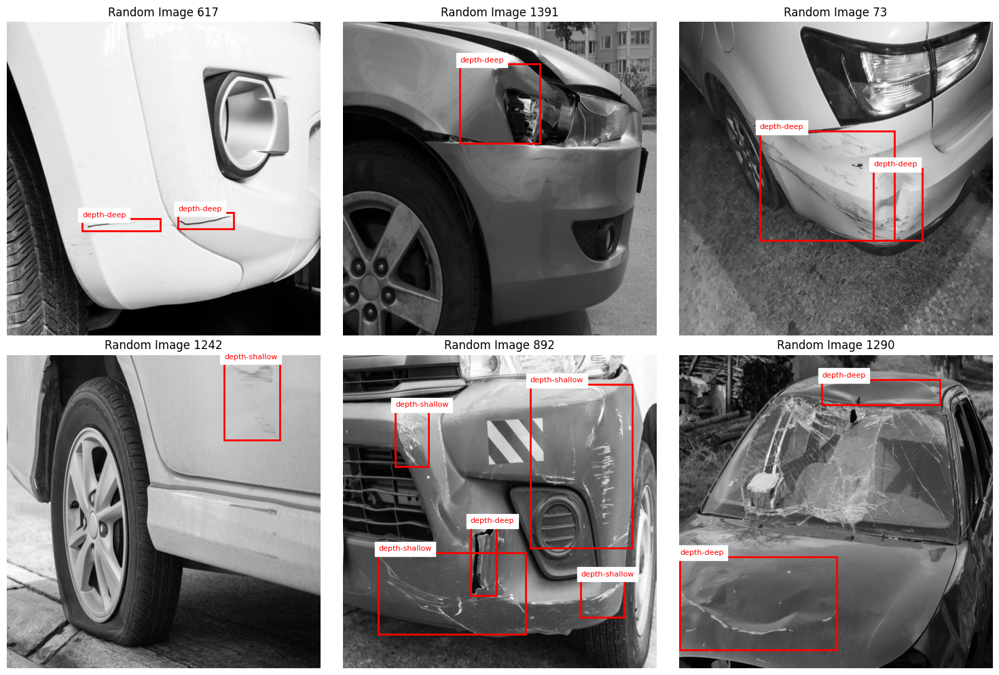

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import random

# Function to display an image with its ROIs and labels
def display_image_with_rois(image, rois, labels, ax):
    ax.imshow(image, cmap='gray')
    ax.axis('off')
    for bbox, label in zip(rois, labels):
        x, y, w, h = bbox
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(x, y - 5, label, color='red', fontsize=8, backgroundcolor='white')

# 🔢 Number of images to display (change as needed)
num_samples = 6

# Randomly select indices from the training data
num_images = len(train_data["images"])
sample_indices = random.sample(range(num_images), min(num_samples, num_images))

# Create subplots
cols = 3
rows = (len(sample_indices) + cols - 1) // cols  # ceiling division
fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))

# Flatten axes if it's 2D
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Display images
for i, idx in enumerate(sample_indices):
    display_image_with_rois(
        train_data["images"][idx],
        train_data["rois"][idx],
        train_data["labels"][idx],
        axes[i]
    )
    axes[i].set_title(f"Random Image {idx}")

# Hide any unused axes
for j in range(len(sample_indices), len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
# Check the format of the labels
print("Checking label formats...")

# Convert labels to NumPy arrays
train_labels = np.array(train_data["labels"])
val_labels = np.array(val_data["labels"])

# Check the format of the labels
print("Checking label formats...")

# Check training labels
print("Training labels:")
print(f"Shape: {train_labels.shape}")
print(f"Sample: {train_labels[:5]}")  # Print the first 5 labels

# Check validation labels
print("\nValidation labels:")
print(f"Shape: {val_labels.shape}")
print(f"Sample: {val_labels[:5]}")  # Print the first 5 labels

# Check if labels are 1D or 2D
if len(train_labels.shape) > 1:
    print("\nTraining labels are 2D. You may need to flatten them.")
else:
    print("\nTraining labels are 1D. Format is correct.")

if len(val_labels.shape) > 1:
    print("Validation labels are 2D. You may need to flatten them.")
else:
    print("Validation labels are 1D. Format is correct.")

Checking label formats...
Checking label formats...
Training labels:
Shape: (1762,)
Sample: [list(['depth-shallow', 'depth-shallow'])
 list(['depth-shallow', 'depth-deep'])
 list(['depth-deep', 'depth-deep', 'depth-shallow', 'depth-shallow'])
 list(['depth-deep']) list(['depth-shallow'])]

Validation labels:
Shape: (524,)
Sample: [list(['depth-deep']) list(['depth-shallow', 'depth-deep'])
 list(['depth-deep', 'depth-deep', 'depth-deep', 'depth-deep'])
 list(['depth-deep', 'depth-deep'])
 list(['depth-deep', 'depth-shallow', 'depth-shallow', 'depth-shallow'])]

Training labels are 1D. Format is correct.
Validation labels are 1D. Format is correct.


<ipython-input-12-24ce7e47ba1a>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  train_labels = np.array(train_data["labels"])
<ipython-input-12-24ce7e47ba1a>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val_labels = np.array(val_data["labels"])


# **Instantiate Model**

**Config list:**
- config_25epochs
- config_20epochs
- config_15epochs
- config_10epochs

In [56]:
# Initialize lightgbm model and data loader
lightgbm_model = GLCMModel(config_50epochs)
print("Model configured successfully.")

Using lightgbm as the classifier.
Model configured successfully.


In [9]:
# Initialize xgboost model and data loader
xgboost_model = GLCMModel(config_50epochs)
print("Model configured successfully.")

Using xgboost as the classifier.
Model configured successfully.


In [ ]:
# Initialize randomforest model and data loader
randomforest_model = GLCMModel(config_20epochs)
print("Model configured successfully.")

Using randomforest as the classifier.
Model configured successfully.


# **Train the Model**

**Config list:**
- config_25epochs
- config_20epochs
- config_15epochs
- config_10epochs

In [12]:
config_50epochs.early_stopping_rounds = 1500

In [13]:
config_50epochs.display()

Configuration Settings:
Dataset Path: /content/GroupEGS-Thesis-Dataset
Classifier Type: xgboost
Model Parameters: {'objective': 'binary:logistic', 'eval_metric': 'logloss', 'n_estimators': 500, 'use_label_encoder': False, 'learning_rate': 0.01, 'max_depth': 6, 'random_state': 42, 'scale_pos_weight': 1.97, 'early_stopping_rounds': 10, 'tree_method': 'hist'}
Distances: [1, 2, 3, 4, 5]
Angles: [0, 0.39269908169872414, 0.7853981633974483, 1.1780972450961724, 1.5707963267948966, 1.9634954084936207, 2.356194490192345, 2.748893571891069]
Levels: 256
Number of Epochs: 5500
Early Stopping Rounds: 1500
Logging Level: INFO


In [ ]:
train_labels = np.array(train_data["labels"])

print(f"Original labels shape: {len(train_data['labels'])}")
print(f"Processed labels shape: {train_labels.shape}")

Original labels shape: 1762
Processed labels shape: (1762,)


<ipython-input-30-e770c5561cec>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  train_labels = np.array(train_data["labels"])


## **Automatic trained model weights download method:**

In [14]:
from IPython.display import FileLink, display
from google.colab import files
import os

def download_file(file_path):
    """
    Display a download link for a file in Jupyter or Google Colab.
    """
    if os.path.exists(file_path):
        print(f"📁 Ready to download: {file_path}")
        display(FileLink(file_path))
        print(f"📁 Downloading: {file_path}")
        files.download(file_path)
    else:
        print(f"❌ File not found: {file_path}")

## **Light BGM Classifier**

In [45]:
!free -h

               total        used        free      shared  buff/cache   available
Mem:            12Gi       8.1Gi       1.7Gi       2.0Mi       2.9Gi       4.3Gi
Swap:             0B          0B          0B


In [46]:
print(f"Model Parameters: {lightgbm_model.model.get_params()}")

Model Parameters: {'boosting_type': 'gbdt', 'class_weight': 'balanced', 'colsample_bytree': 0.85, 'importance_type': 'gain', 'learning_rate': 0.035, 'max_depth': 12, 'min_child_samples': 10, 'min_child_weight': 8, 'min_split_gain': 0.01, 'n_estimators': 5000, 'n_jobs': None, 'num_leaves': 2048, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.8, 'reg_lambda': 4, 'subsample': 0.85, 'subsample_for_bin': 250000, 'subsample_freq': 1, 'scale_pos_weight': 3.75}


In [61]:
lightgbm_model.model.set_params(scale_pos_weight=2)

LGBMClassifier(class_weight='balanced', colsample_bytree=0.85,
               importance_type='gain', learning_rate=0.035, max_depth=12,
               min_child_samples=10, min_child_weight=8, min_split_gain=0.01,
               n_estimators=5000, num_leaves=2048, objective='binary',
               random_state=42, reg_alpha=0.8, reg_lambda=4,
               scale_pos_weight=2.5, subsample=0.85, subsample_for_bin=250000,
               subsample_freq=1)

In [59]:
lightgbm_model.model.get_params()["scale_pos_weight"]

2.5

In [60]:
lightgbm_model.model.scale_pos_weight = 2.5
lightgbm_model.model.boosting_type = "gbdt"
lightgbm_model.model.objective = "binary"
lightgbm_model.model.max_depth = 12                 # Slightly deeper trees for more expressive splits
lightgbm_model.model.num_leaves = 2048              # Match 2^12, leverage deeper splits without overfitting

# Regularization
lightgbm_model.model.reg_alpha = 0.8                # Slightly stronger L1 regularization
lightgbm_model.model.reg_lambda = 4                 # Slightly stronger L2 regularization
lightgbm_model.model.min_child_weight = 8           # Discourage overly specific splits

# Sampling (keep good diversity)
lightgbm_model.model.subsample = 0.85
lightgbm_model.model.subsample_freq = 1
lightgbm_model.model.subsample_for_bin = 250000
lightgbm_model.model.colsample_bytree = 0.85

# Controlling complexity
lightgbm_model.model.min_child_samples = 10         # Helps generalization on small/shallow regions
lightgbm_model.model.min_split_gain = 0.01          # Require slight gain for splitting to reduce noise

# Learning and boosting
lightgbm_model.model.learning_rate = 0.035          # Lower LR for better generalization
lightgbm_model.model.n_estimators = 5000            # Higher for more boosting rounds

# Class imbalance focus
lightgbm_model.model.class_weight = "balanced"      # Auto-adjusts weights based on class frequencies
        # Optional: fine-tuned based on your imbalance ratio

# Utility
lightgbm_model.model.importance_type = "gain"
lightgbm_model.model.verbose = 1

In [62]:
lightgbm_model.model.get_params()["scale_pos_weight"]

2.5

In [63]:
print(f"Model Parameters: {lightgbm_model.model.get_params()}")

Model Parameters: {'boosting_type': 'gbdt', 'class_weight': 'balanced', 'colsample_bytree': 0.85, 'importance_type': 'gain', 'learning_rate': 0.035, 'max_depth': 12, 'min_child_samples': 10, 'min_child_weight': 8, 'min_split_gain': 0.01, 'n_estimators': 5000, 'n_jobs': None, 'num_leaves': 2048, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.8, 'reg_lambda': 4, 'subsample': 0.85, 'subsample_for_bin': 250000, 'subsample_freq': 1, 'scale_pos_weight': 2.5}


In [64]:
!cat /proc/meminfo | grep Mem

MemTotal:       13289424 kB
MemFree:         2041036 kB
MemAvailable:    4754340 kB


In [65]:
# Train the model
print("Starting training...")
lightgbm_model.train(train_data, val_data)
print("Training completed.")

Starting training...
Extracting GLCM features for training data...
Number of training images: 1008
Number of training ROIs: 1974


Training GLCM Extraction: 100%|██████████| 1008/1008 [1:51:54<00:00,  6.66s/it]

Shape of train_features before preprocessing: (1974, 672)
Shape of train_labels before preprocessing: (1974,)
Final shape of train_features: (1974, 672)
Final shape of train_labels: (1974,)

📋 GLCM Feature Summary by Class (Training Set):

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,547.1991,535.5303,576.0987,562.6125,515.3653,515.7949
1,451.1994,435.1780,467.6440,457.0601,417.6507,416.9099



📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.3005,2.2777,4.3091,4.1988,5.0267,4.7990
1,2.3184,2.2893,4.4340,4.2057,5.0019,4.8299



📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,342.4636,332.6472,339.2172,318.9500,289.5406,288.9963
1,341.5054,325.5538,340.1729,321.0505,296.3293,293.2509



📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.4749,-2.4721,-2.4710,-2.4749,-2.4672,-2.4678
1,-2.4749,-2.4078,-2.3985,-2.4749,-2.4411,-2.4749



📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,22629.8983,23762.0904,24407.5813,21188.3445,22301.2136,23500.3540
1,20692.4221,19116.4610,20263.0000,17380.3437,20263.0000,20296.8571



📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,1.8873,1.9334,1.6237,1.6155,1.1461,1.1292
1,1.7731,1.7644,1.4409,1.5007,1.1776,1.1565


Extracting GLCM features for validation data...


Validation GLCM Extraction: 100%|██████████| 290/290 [33:03<00:00,  6.84s/it]


Shape of val_features: (583, 672)
Shape of val_labels: (583,)
Starting training...
[LightGBM] [Info] Number of positive: 709, number of negative: 1265
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018685 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 171360
[LightGBM] [Info] Number of data points in the train set: 1974, number of used features: 672
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[1]	valid_0's binary_logloss: 0.689615	valid_0's binary_error: 0.457976	valid_0's auc: 0.686603
Training until validation scores don't improve for 1500 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[2]	valid_0's binary_logloss: 0.685557	valid_0's binary_error: 0.399657	valid_0's auc: 0.723873
[LightGBM] [Warning] 

In [ ]:
download_file("/content/lightgbm.best_trained-glcm_model.txt")
download_file("/content/lightgbm_mlb.json")

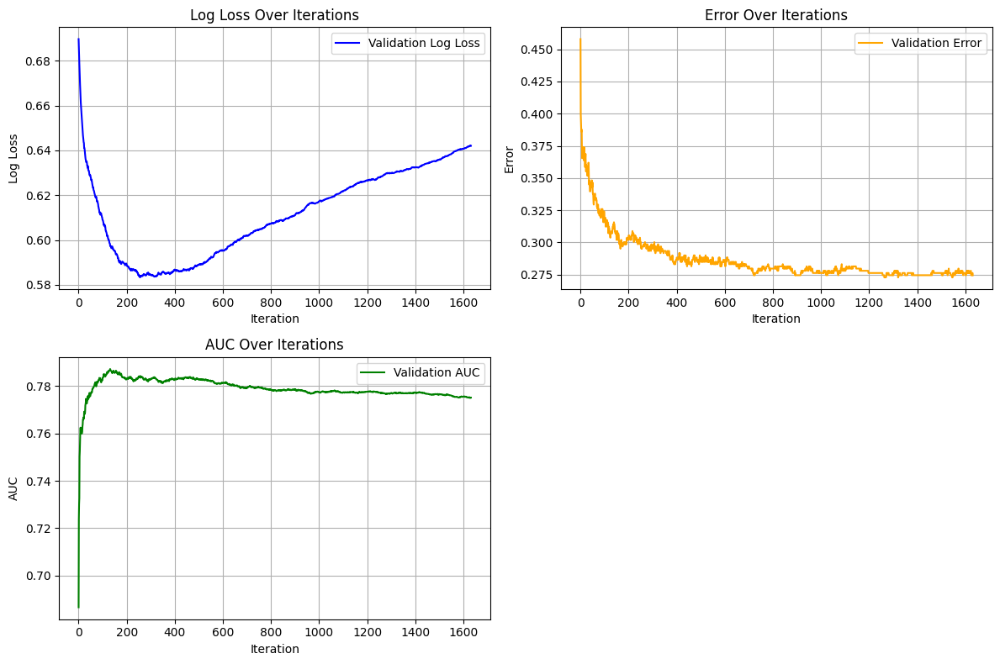

In [66]:
import matplotlib.pyplot as plt

# Evaluation results dictionary
results = lightgbm_model.model.evals_result_

# Metric names used in your training
metrics_to_plot = {
    "binary_logloss": "Log Loss",
    "binary_error": "Error",
    "auc": "AUC"
}
colors = ['blue', 'orange', 'green']

plt.figure(figsize=(12, 8))

# Plot available metrics
for i, (metric_key, metric_name) in enumerate(metrics_to_plot.items()):
    if metric_key in results['valid_0']:
        plt.subplot(2, 2, i+1)
        plt.plot(results['valid_0'][metric_key], label=f'Validation {metric_name}', color=colors[i])
        plt.title(f"{metric_name} Over Iterations")
        plt.xlabel("Iteration")
        plt.ylabel(metric_name)
        plt.grid(True)
        plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
lightgbm_model.save_model("/content/lightgbm.best_trained-glcm_model.txt", "/content/lightgbm.mlb.json")

✅ Full model saved to /content/lightgbm.best_trained-glcm_model.txt
✅ MultiLabelBinarizer saved to /content/lightgbm.mlb.json


## **XGBoost Classifier**

In [15]:
print(f"Model Parameters: {xgboost_model.model.get_params()}")

Model Parameters: {'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': 10, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'feature_weights': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.01, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 6, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': 500, 'n_jobs': None, 'num_parallel_tree': None, 'random_state': 42, 'reg_alpha': None, 'reg_lambda': None, 'sampling_method': None, 'scale_pos_weight': 1.97, 'subsample': None, 'tree_method': 'hist', 'validate_parameters': None, 'verbosity': None, 'use_label_encoder': False}


In [16]:
xgboost_model.model.max_depth = 50
xgboost_model.model.max_leaves = 15000
xgboost_model.model.tree_method = "hist"
xgboost_model.model.grow_policy = "depthwise"
xgboost_model.model.booster = "gbtree"

# Regularization
xgboost_model.model.reg_alpha = 0.5
xgboost_model.model.reg_lambda = 3
xgboost_model.model.gamma = 0.35
xgboost_model.model.min_child_weight = 10

# Sampling
xgboost_model.model.subsample = 0.8
xgboost_model.model.colsample_bytree = 0.8
xgboost_model.model.colsample_bylevel = 0.9

# Imbalance handling
xgboost_model.model.scale_pos_weight = 4.5  # ~5 is considered the perceived limit

# Training control
xgboost_model.model.n_estimators = 25000
xgboost_model.model.learning_rate = 0.045
xgboost_model.model.early_stopping_rounds = 1500

# Metrics & verbosity
xgboost_model.model.eval_metric = ["logloss", "error", "auc", "aucpr"]
xgboost_model.model.verbosity = 2

In [17]:
print(f"Model Parameters: {xgboost_model.model.get_params()}")

Model Parameters: {'objective': 'binary:logistic', 'base_score': None, 'booster': 'gbtree', 'callbacks': None, 'colsample_bylevel': 0.9, 'colsample_bynode': None, 'colsample_bytree': 0.8, 'device': None, 'early_stopping_rounds': 1500, 'enable_categorical': False, 'eval_metric': ['logloss', 'error', 'auc', 'aucpr'], 'feature_types': None, 'feature_weights': None, 'gamma': 0.35, 'grow_policy': 'depthwise', 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.045, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 50, 'max_leaves': 15000, 'min_child_weight': 10, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': 25000, 'n_jobs': None, 'num_parallel_tree': None, 'random_state': 42, 'reg_alpha': 0.5, 'reg_lambda': 3, 'sampling_method': None, 'scale_pos_weight': 4.5, 'subsample': 0.8, 'tree_method': 'hist', 'validate_parameters': None, 'verbosity': 2, 'use_label_encoder': False

In [18]:
# Train the model
print("Starting training...")
xgboost_model.train(train_data, val_data)
print("Training completed.")

Starting training...
Extracting GLCM features for training data...
Number of training images: 1008
Number of training ROIs: 1974


Training GLCM Extraction: 100%|██████████| 1008/1008 [34:18<00:00,  2.04s/it]

Shape of train_features before preprocessing: (1974, 672)
Shape of train_labels before preprocessing: (1974,)
Final shape of train_features: (1974, 672)
Final shape of train_labels: (1974,)

📋 GLCM Feature Summary by Class (Training Set):

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,547.1991,535.5303,576.0987,562.6125,515.3653,515.7949
1,451.1994,435.1780,467.6440,457.0601,417.6507,416.9099



📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.3005,2.2777,4.3091,4.1988,5.0267,4.7990
1,2.3184,2.2893,4.4340,4.2057,5.0019,4.8299



📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,342.4636,332.6472,339.2172,318.9500,289.5406,288.9963
1,341.5054,325.5538,340.1729,321.0505,296.3293,293.2509



📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.4749,-2.4721,-2.4710,-2.4749,-2.4672,-2.4678
1,-2.4749,-2.4078,-2.3985,-2.4749,-2.4411,-2.4749



📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,22629.8983,23762.0904,24407.5813,21188.3445,22301.2136,23500.3540
1,20692.4221,19116.4610,20263.0000,17380.3437,20263.0000,20296.8571



📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,1.8873,1.9334,1.6237,1.6155,1.1461,1.1292
1,1.7731,1.7644,1.4409,1.5007,1.1776,1.1565


Extracting GLCM features for validation data...


Validation GLCM Extraction: 100%|██████████| 290/290 [09:51<00:00,  2.04s/it]

Shape of val_features: (583, 672)
Shape of val_labels: (583,)

📋 GLCM Feature Summary by Class (Validation Set):

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,547.1991,535.5303,576.0987,562.6125,515.3653,515.7949
1,451.1994,435.1780,467.6440,457.0601,417.6507,416.9099



📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.3005,2.2777,4.3091,4.1988,5.0267,4.7990
1,2.3184,2.2893,4.4340,4.2057,5.0019,4.8299



📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,342.4636,332.6472,339.2172,318.9500,289.5406,288.9963
1,341.5054,325.5538,340.1729,321.0505,296.3293,293.2509



📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.4749,-2.4721,-2.4710,-2.4749,-2.4672,-2.4678
1,-2.4749,-2.4078,-2.3985,-2.4749,-2.4411,-2.4749



📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,22629.8983,23762.0904,24407.5813,21188.3445,22301.2136,23500.3540
1,20692.4221,19116.4610,20263.0000,17380.3437,20263.0000,20296.8571



📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,1.8873,1.9334,1.6237,1.6155,1.1461,1.1292
1,1.7731,1.7644,1.4409,1.5007,1.1776,1.1565


Starting training...
[03:47:52] INFO: /workspace/src/data/iterative_dmatrix.cc:53: Finished constructing the `IterativeDMatrix`: (1974, 672, 1326528).
[03:47:52] INFO: /workspace/src/data/iterative_dmatrix.cc:53: Finished constructing the `IterativeDMatrix`: (583, 672, 391776).
[0]	validation_0-logloss:0.87081	validation_0-error:0.61750	validation_0-auc:0.68811	validation_0-aucpr:0.55659


/usr/local/lib/python3.11/dist-packages/xgboost/callback.py:386: UserWarning: [03:47:52] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  self.starting_round = model.num_boosted_rounds()


[1]	validation_0-logloss:0.85891	validation_0-error:0.61750	validation_0-auc:0.71518	validation_0-aucpr:0.57684
[2]	validation_0-logloss:0.84743	validation_0-error:0.61750	validation_0-auc:0.72818	validation_0-aucpr:0.61806
[3]	validation_0-logloss:0.83621	validation_0-error:0.61750	validation_0-auc:0.73805	validation_0-aucpr:0.64696
[4]	validation_0-logloss:0.82346	validation_0-error:0.61750	validation_0-auc:0.74500	validation_0-aucpr:0.65610
[5]	validation_0-logloss:0.81284	validation_0-error:0.61750	validation_0-auc:0.74590	validation_0-aucpr:0.65791
[6]	validation_0-logloss:0.80364	validation_0-error:0.61750	validation_0-auc:0.74605	validation_0-aucpr:0.65542
[7]	validation_0-logloss:0.79626	validation_0-error:0.61750	validation_0-auc:0.74839	validation_0-aucpr:0.65826
[8]	validation_0-logloss:0.78899	validation_0-error:0.61063	validation_0-auc:0.74857	validation_0-aucpr:0.65193
[9]	validation_0-logloss:0.78161	validation_0-error:0.59863	validation_0-auc:0.75372	validation_0-aucpr:

In [ ]:
download_file("/content/xgboost.best_trained-glcm_model.txt")
download_file("/content/xgboost_mlb.json")

📁 Ready to download: /content/xgboost.best_trained-glcm_model.txt


/content/xgboost.best_trained-glcm_model.txt

📁 Downloading: /content/xgboost.best_trained-glcm_model.txt


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

📁 Ready to download: /content/xgboost_mlb.json


/content/xgboost_mlb.json

📁 Downloading: /content/xgboost_mlb.json


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

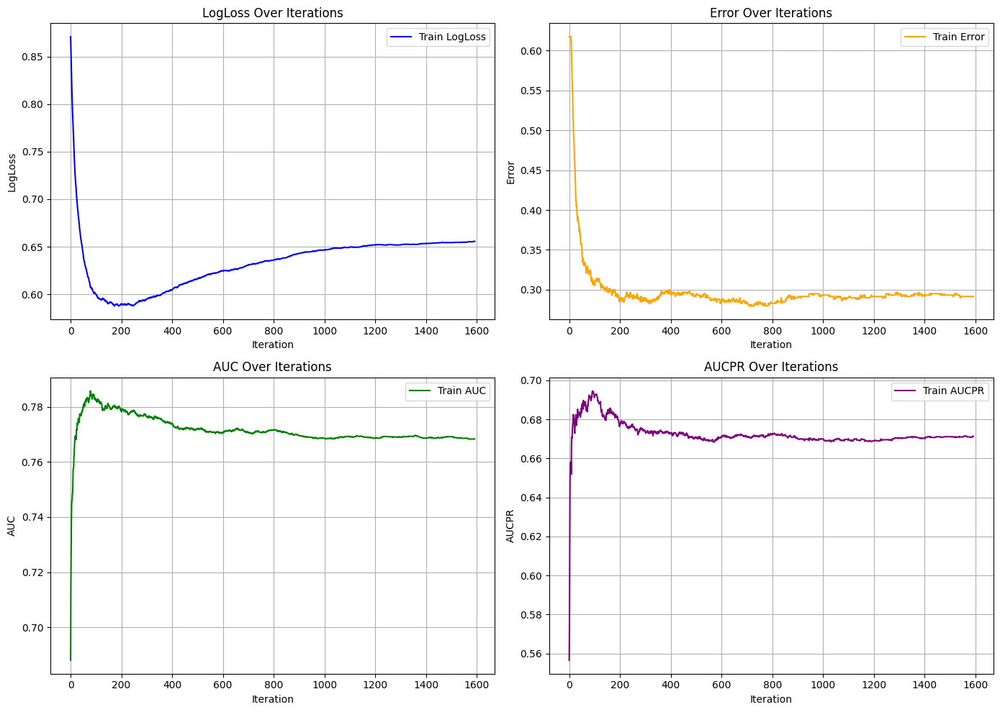

In [21]:
import matplotlib.pyplot as plt

# Get evaluation results
results = xgboost_model.model.evals_result()

plt.figure(figsize=(14, 10))

# LogLoss
plt.subplot(2, 2, 1)
plt.plot(results["validation_0"]["logloss"], label="Train LogLoss", color='blue')
plt.title("LogLoss Over Iterations")
plt.xlabel("Iteration")
plt.ylabel("LogLoss")
plt.grid(True)
plt.legend()

# Error
plt.subplot(2, 2, 2)
plt.plot(results["validation_0"]["error"], label="Train Error", color='orange')
plt.title("Error Over Iterations")
plt.xlabel("Iteration")
plt.ylabel("Error")
plt.grid(True)
plt.legend()

# AUC
plt.subplot(2, 2, 3)
plt.plot(results["validation_0"]["auc"], label="Train AUC", color='green')
plt.title("AUC Over Iterations")
plt.xlabel("Iteration")
plt.ylabel("AUC")
plt.grid(True)
plt.legend()

# AUCPR
plt.subplot(2, 2, 4)
plt.plot(results["validation_0"]["aucpr"], label="Train AUCPR", color='purple')
plt.title("AUCPR Over Iterations")
plt.xlabel("Iteration")
plt.ylabel("AUCPR")
plt.grid(True)
plt.legend()

plt.tight_layout()
plt.show()

## **Random Forest Classifier**

In [ ]:
print(f"Model Parameters: {randomforest_model.model.get_params()}")

Model Parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 200, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}


In [ ]:
# Train the model
print("Starting training...")
randomforest_model.train(train_data, val_data)
print("Training completed.")

Starting training...
Extracting GLCM features for training data...
Number of training images: 1762
Number of training ROIs: 4167


Training GLCM Extraction: 100%|██████████| 1762/1762 [09:57<00:00,  2.95it/s]


Shape of train_features before preprocessing: (4167, 192)
Shape of train_labels before preprocessing: (4167,)
Final shape of train_features: (4167, 192)
Final shape of train_labels: (4167,)
Extracting GLCM features for validation data...


Validation GLCM Extraction: 100%|██████████| 524/524 [02:41<00:00,  3.24it/s]


Shape of val_features: (1229, 192)
Shape of val_labels: (1229,)
Starting training...
✅ Full model saved to randomforest.best_trained-glcm_model.txt
✅ MultiLabelBinarizer saved to randomforest_mlb.json
✅ Training completed.
🌲 Number of trees in trained model: 200
Training completed.
📁 Ready to download: /content/randomforest.best_trained-glcm_model.txt


/content/randomforest.best_trained-glcm_model.txt

📁 Downloading: /content/randomforest.best_trained-glcm_model.txt


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

❌ File not found: /randomforest_mlb.json


In [ ]:
download_file("/content/randomforest.best_trained-glcm_model.txt")
download_file("/content/randomforest_mlb.json")

📁 Ready to download: /content/randomforest.best_trained-glcm_model.txt


/content/randomforest.best_trained-glcm_model.txt

📁 Downloading: /content/randomforest.best_trained-glcm_model.txt


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

📁 Ready to download: /content/randomforest_mlb.json


/content/randomforest_mlb.json

📁 Downloading: /content/randomforest_mlb.json


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **Perform Predictions**

In [ ]:
# Run prediction
lgbm_prediction_result = lightgbm_model.predict(test_data["images"], test_data["rois"])

features = lgbm_prediction_result["features"]
labels = np.concatenate(lgbm_prediction_result["predictions"])

print(f"[Debug] GLCM Features Shape: {features.shape}")
print(f"[Debug] Number of Labels: {len(labels)}")

lightgbm_model.create_feature_summary_tables(features, labels, save_to_csv=True)

In [ ]:
xgb_prediction_result = xgboost_model.predict(test_data["images"], test_data["rois"])

Extracting GLCM features for the specified data...


Prediction Progress: 100%|██████████| 251/251 [01:54<00:00,  2.19it/s]


[Debug] Extracted input features shape: (633, 192)
[Debug] Total ROI predictions expected: 633

📷 Predictions for Image 42:
ROIs: [[355, 403, 179, 130], [361, 435, 209, 279]]
Predicted labels (numeric): [1, 1]
Predicted labels (named): ['depth-shallow', 'depth-shallow']


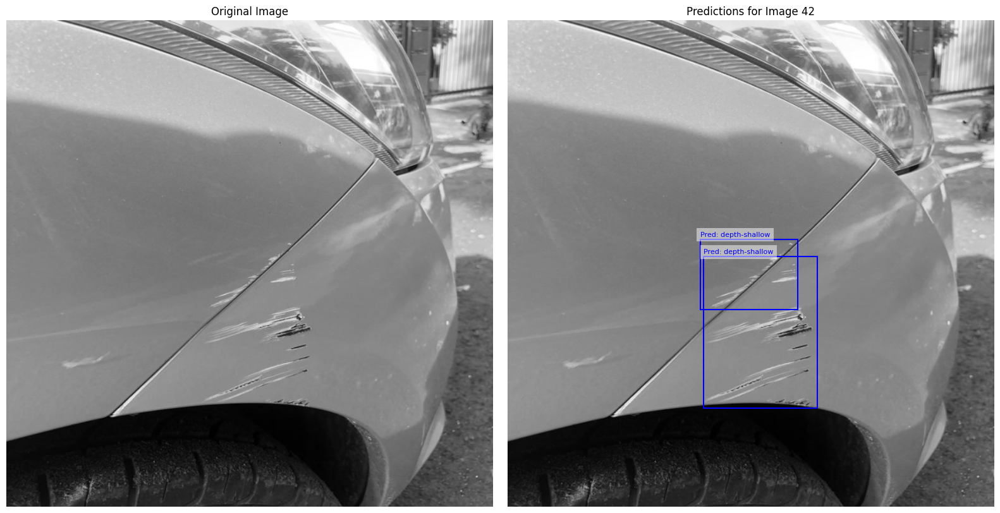


📷 Predictions for Image 18:
ROIs: [[0, 33, 895, 801]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


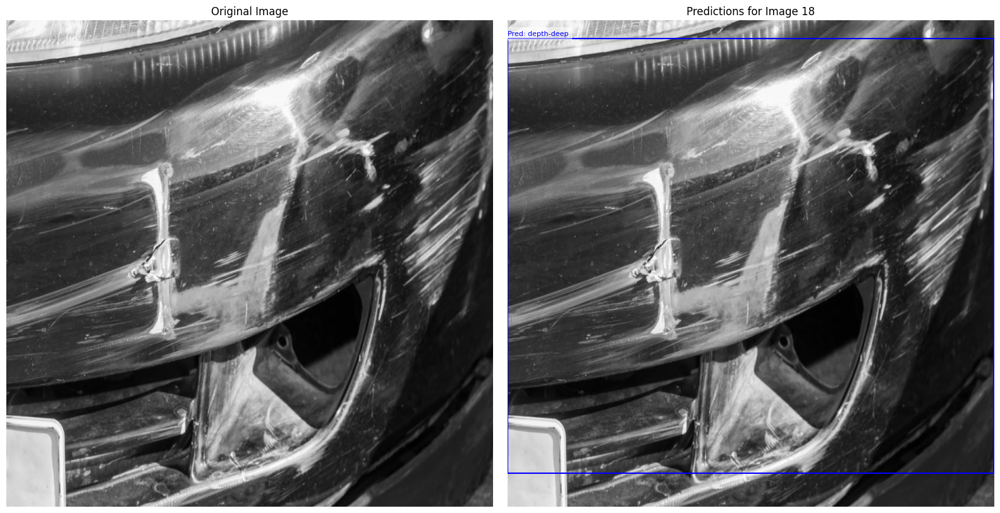


📷 Predictions for Image 202:
ROIs: [[206, 846, 252, 25], [0, 392, 165, 199], [641, 376, 252, 460], [50, 151, 722, 594]]
Predicted labels (numeric): [1, 1, 0, 0]
Predicted labels (named): ['depth-shallow', 'depth-shallow', 'depth-deep', 'depth-deep']


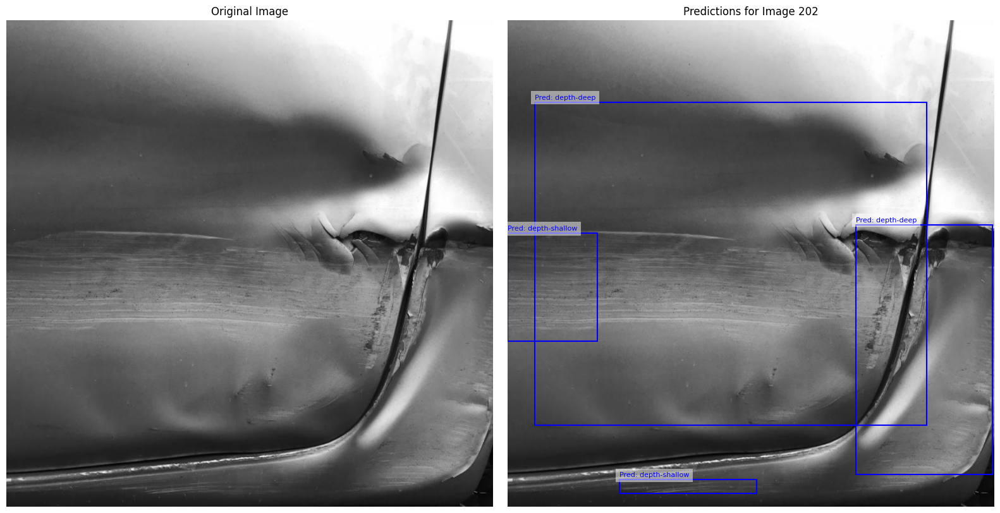


📷 Predictions for Image 49:
ROIs: [[349, 438, 67, 76], [103, 526, 436, 198], [510, 324, 87, 126], [247, 352, 166, 97]]
Predicted labels (numeric): [1, 0, 0, 0]
Predicted labels (named): ['depth-shallow', 'depth-deep', 'depth-deep', 'depth-deep']


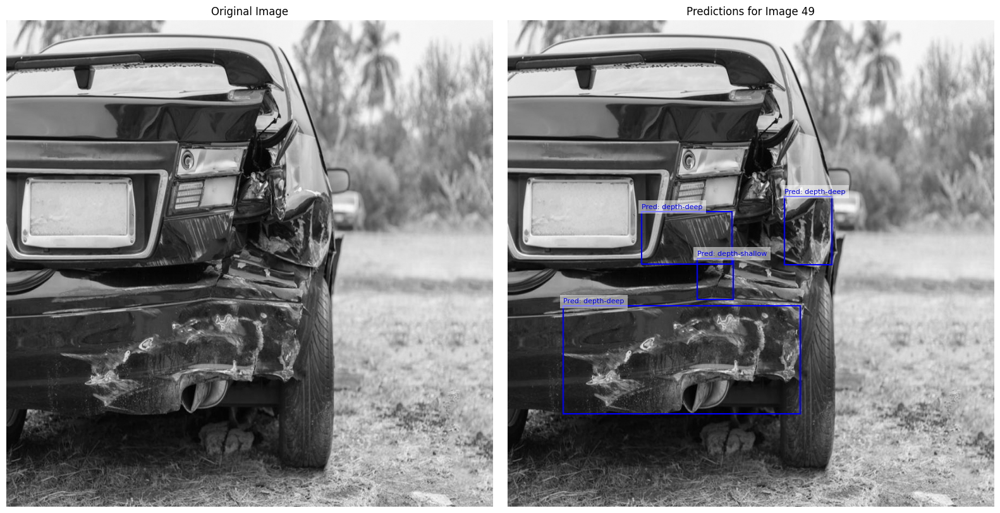


📷 Predictions for Image 192:
ROIs: [[287, 529, 408, 365], [164, 235, 329, 336]]
Predicted labels (numeric): [0, 0]
Predicted labels (named): ['depth-deep', 'depth-deep']


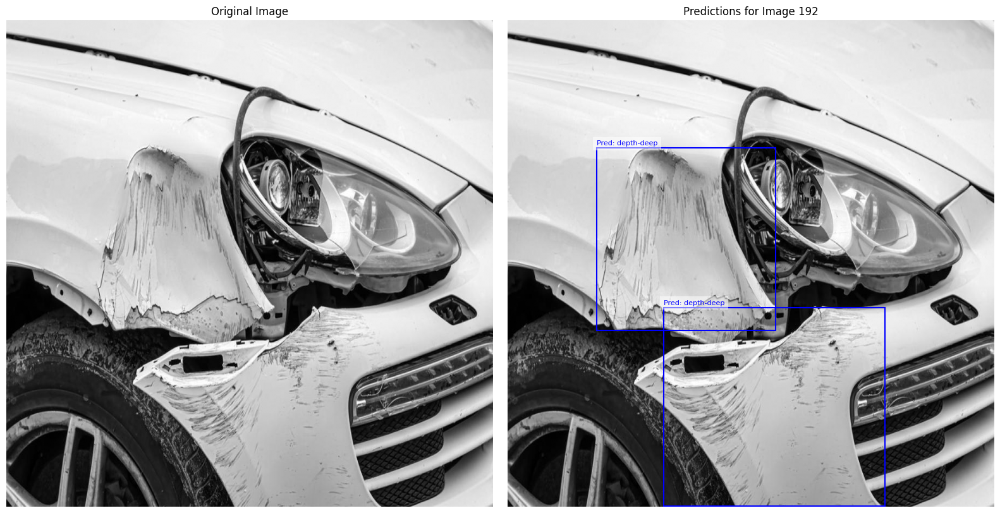

KeyError: 'confidences'

In [ ]:
rf_prediction_result = randomforest_model.predict(test_data["images"], test_data["rois"])

# **Post-training Model Evaluation**

Extracting GLCM features for the specified data...


Prediction Progress: 100%|██████████| 142/142 [04:40<00:00,  1.98s/it]


[Debug] Extracted input features shape: (264, 672)
[Debug] Total ROI predictions expected: 264

📷 Predictions for Image 43:
ROIs: [[180, 111, 715, 491], [502, 668, 171, 102]]
Predicted labels (numeric): [0, 1]
Predicted labels (named): ['depth-deep', 'depth-shallow']


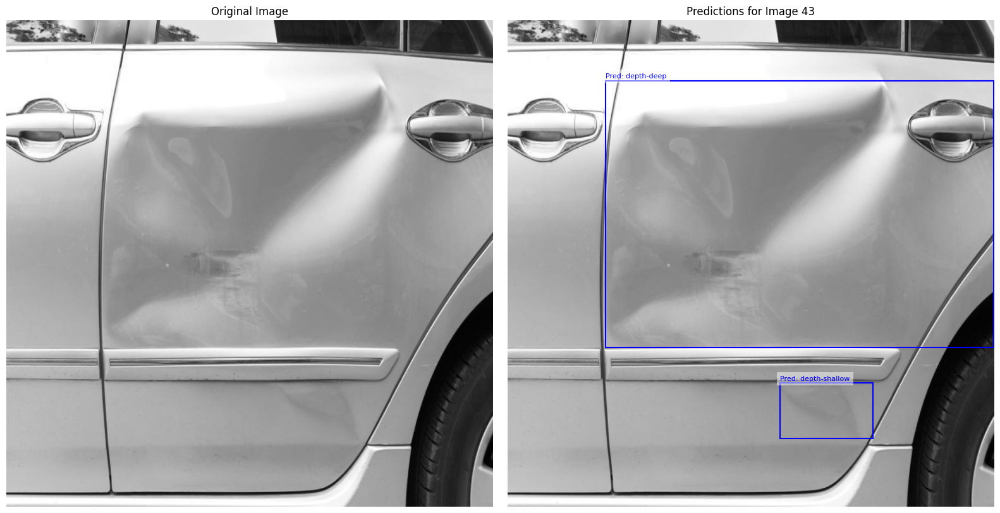

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[180, 111, 715, 491]",depth-deep,1121.0411,0.2552,8.2577,0.3790,1356.7379,3.4215
1,"[502, 668, 171, 102]",depth-shallow,130.6027,0.3369,6.5525,0.3361,147.6595,2.9131



📷 Predictions for Image 55:
ROIs: [[300, 143, 570, 535]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


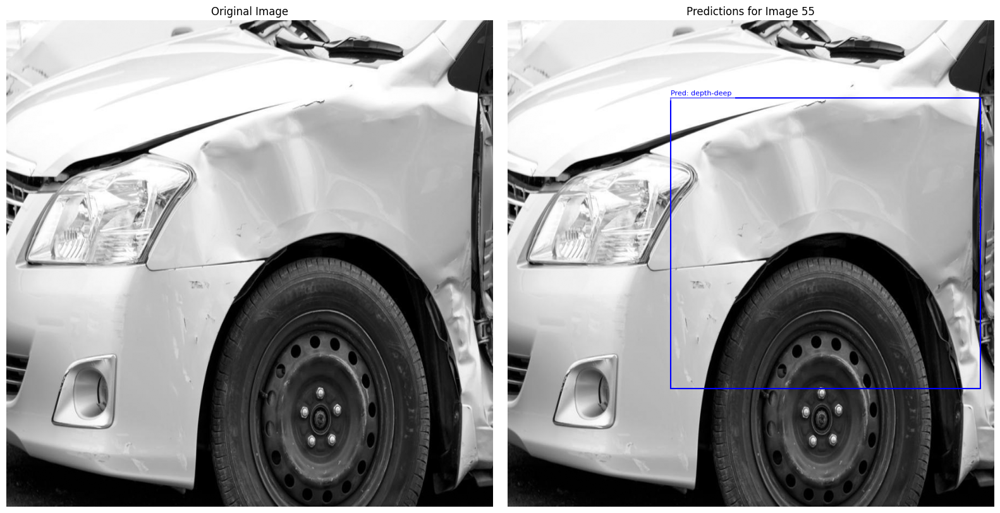

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[300, 143, 570, 535]",depth-deep,2395.0219,0.1798,8.7101,0.3053,2838.5284,3.8476



📷 Predictions for Image 140:
ROIs: [[240, 441, 440, 70], [409, 376, 424, 253], [427, 209, 330, 150]]
Predicted labels (numeric): [1, 1, 1]
Predicted labels (named): ['depth-shallow', 'depth-shallow', 'depth-shallow']


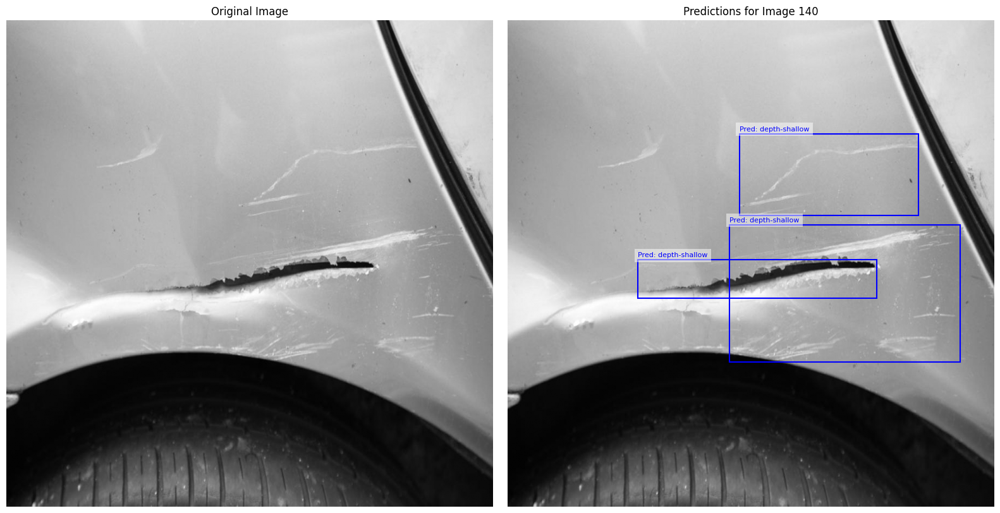

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[240, 441, 440, 70]",depth-shallow,1354.6774,0.1652,8.4476,0.1998,1902.1827,4.0169
1,"[409, 376, 424, 253]",depth-shallow,959.1530,0.1428,7.8963,0.2130,1269.9194,3.4887
2,"[427, 209, 330, 150]",depth-shallow,287.1670,0.1707,7.4997,0.1297,350.4453,3.2839



📷 Predictions for Image 105:
ROIs: [[848, 531, 40, 50], [136, 308, 307, 299], [437, 284, 406, 328]]
Predicted labels (numeric): [1, 0, 0]
Predicted labels (named): ['depth-shallow', 'depth-deep', 'depth-deep']


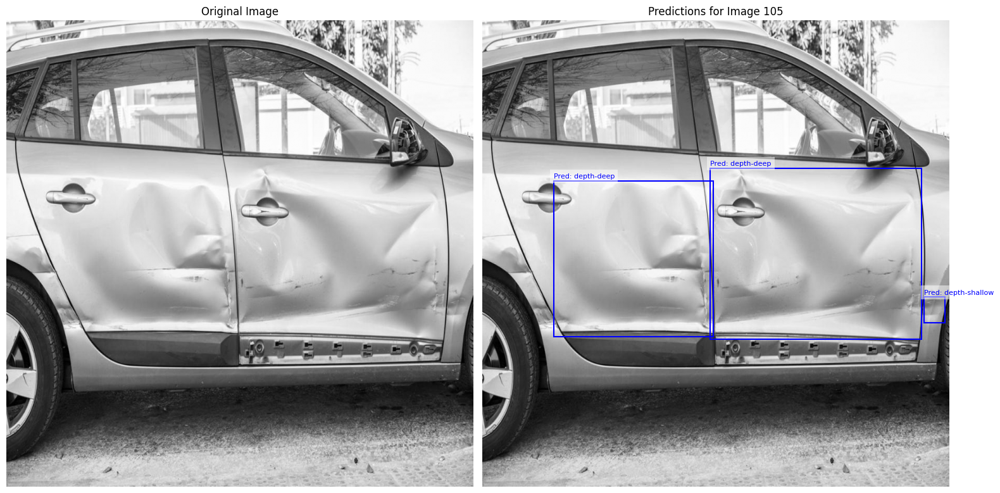

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[848, 531, 40, 50]",depth-shallow,2675.4871,0.1061,6.0869,0.1020,1831.0021,4.0214
1,"[136, 308, 307, 299]",depth-deep,895.0695,0.2113,7.6581,0.2055,1007.9022,3.2547
2,"[437, 284, 406, 328]",depth-deep,1015.7116,0.2627,8.0336,0.1251,1123.4110,3.3827



📷 Predictions for Image 113:
ROIs: [[0, 0, 464, 519]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


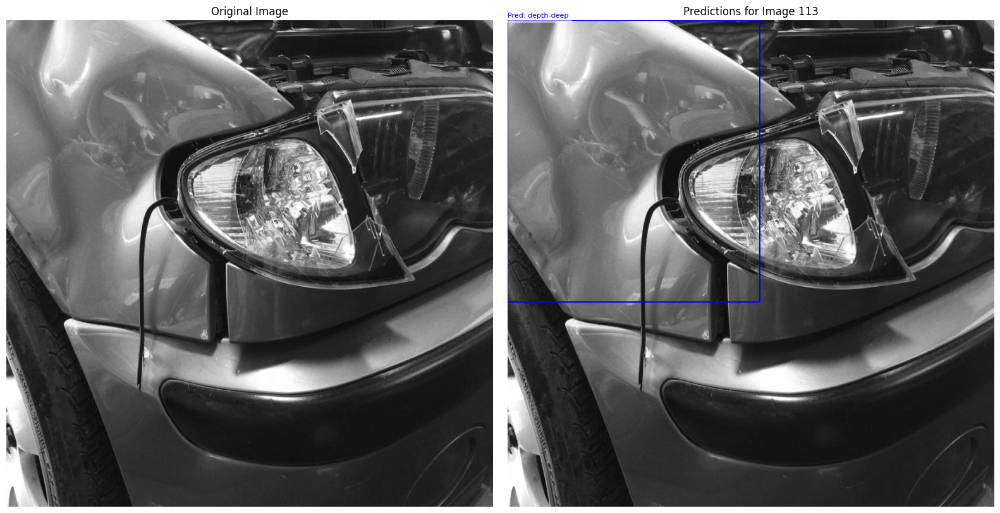

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[0, 0, 464, 519]",depth-deep,1913.1806,0.0252,9.5178,0.0583,1890.5671,4.1854


Test Accuracy: 0.65
Classification Report:
                precision    recall  f1-score   support

   depth-deep       0.66      0.63      0.65       134
depth-shallow       0.64      0.66      0.65       130

     accuracy                           0.65       264
    macro avg       0.65      0.65      0.65       264
 weighted avg       0.65      0.65      0.65       264


Confusion Matrix:


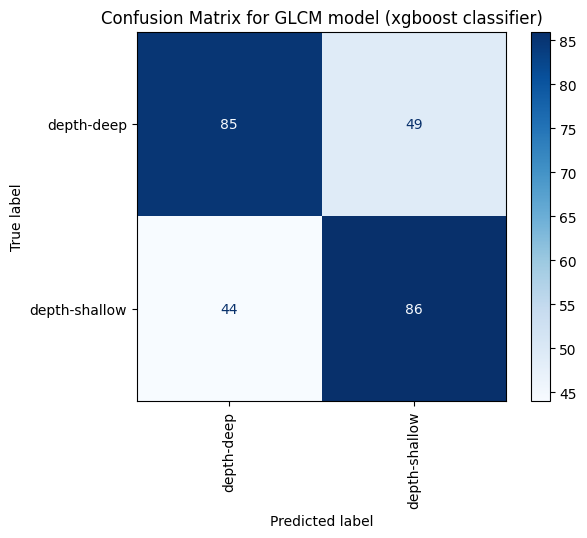

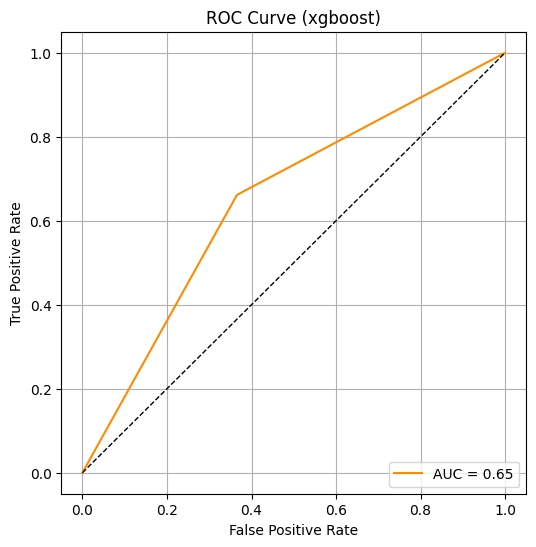

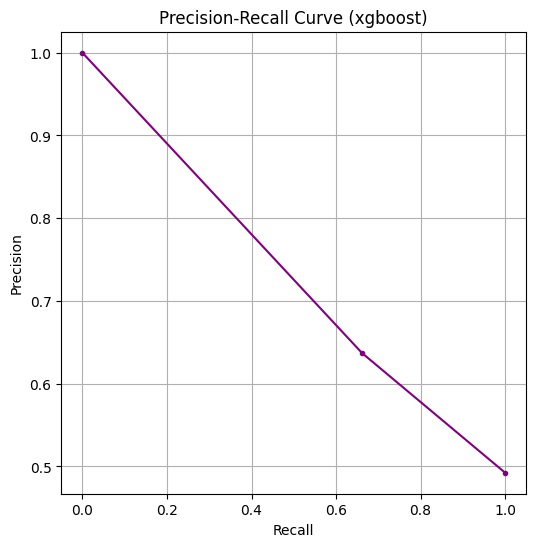

Mean Average Precision (mAP): 0.59


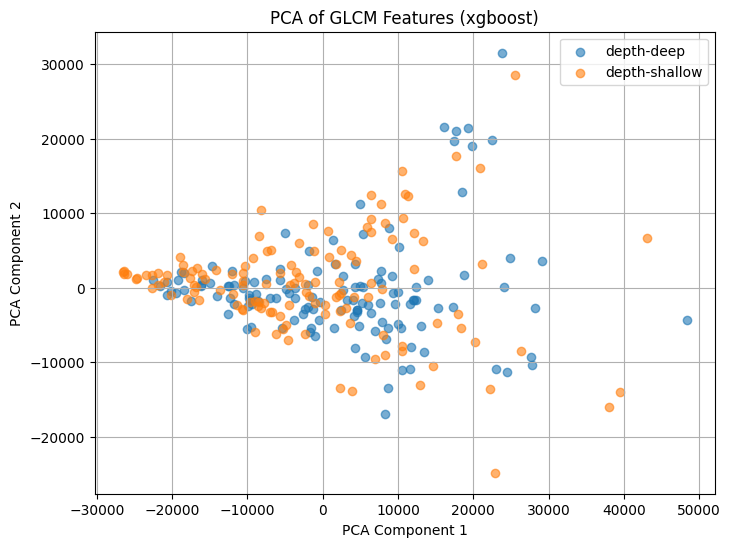

Visualizing predictions vs ground truth for image 97...
ROIs for image 96: [[370, 79, 524, 815], [267, 483, 219, 412]]
GT labels: ['depth-shallow', 'depth-shallow']
Predictions: [0, 1]


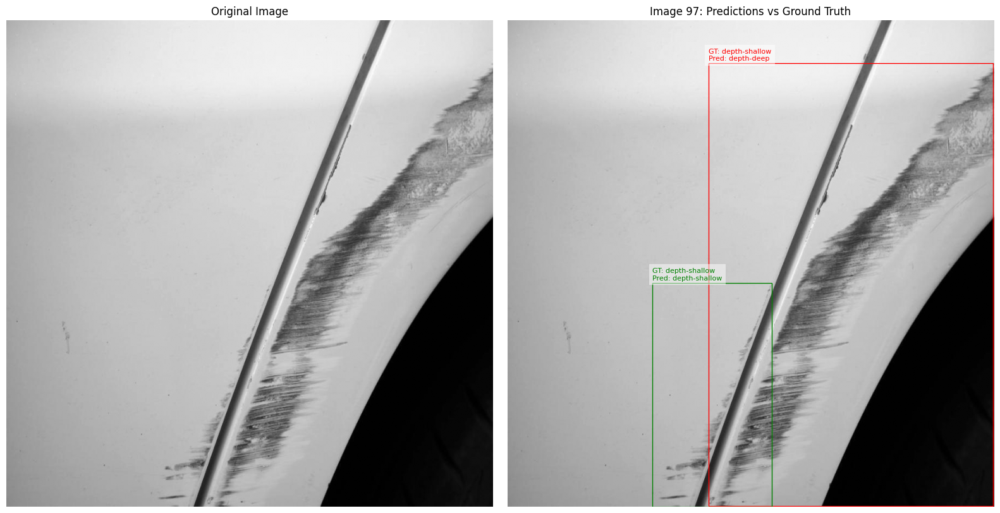

Visualizing predictions vs ground truth for image 78...
ROIs for image 77: [[393, 572, 60, 203], [147, 215, 161, 498], [265, 504, 172, 281]]
GT labels: ['depth-shallow', 'depth-shallow', 'depth-deep']
Predictions: [1, 0, 0]


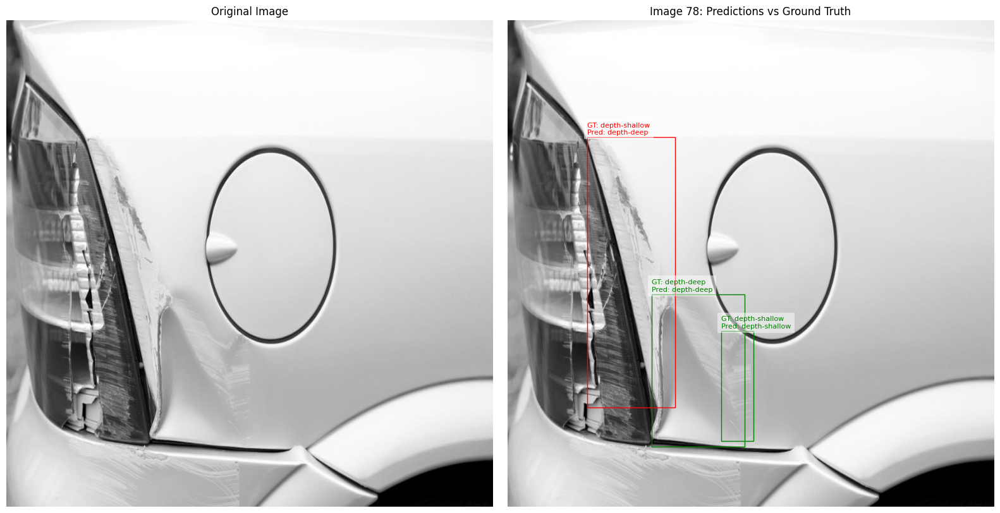

Visualizing predictions vs ground truth for image 62...
ROIs for image 61: [[544, 282, 160, 292], [63, 110, 492, 719], [103, 555, 433, 339], [0, 469, 21, 212], [600, 155, 31, 95], [210, 146, 331, 551]]
GT labels: ['depth-shallow', 'depth-deep', 'depth-deep', 'depth-shallow', 'depth-shallow', 'depth-deep']
Predictions: [0, 0, 0, 1, 1, 1]


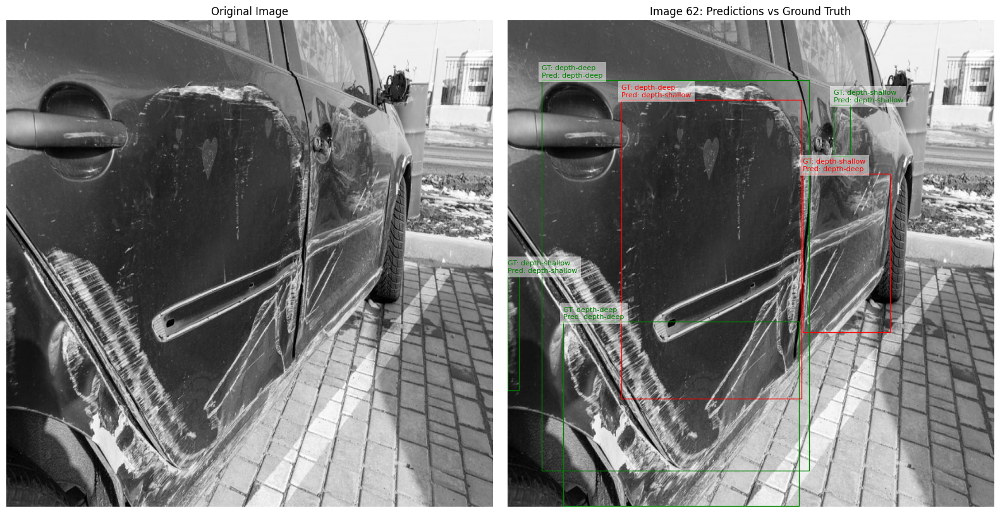

Visualizing predictions vs ground truth for image 92...
ROIs for image 91: [[443, 213, 89, 152]]
GT labels: ['depth-deep']
Predictions: [1]


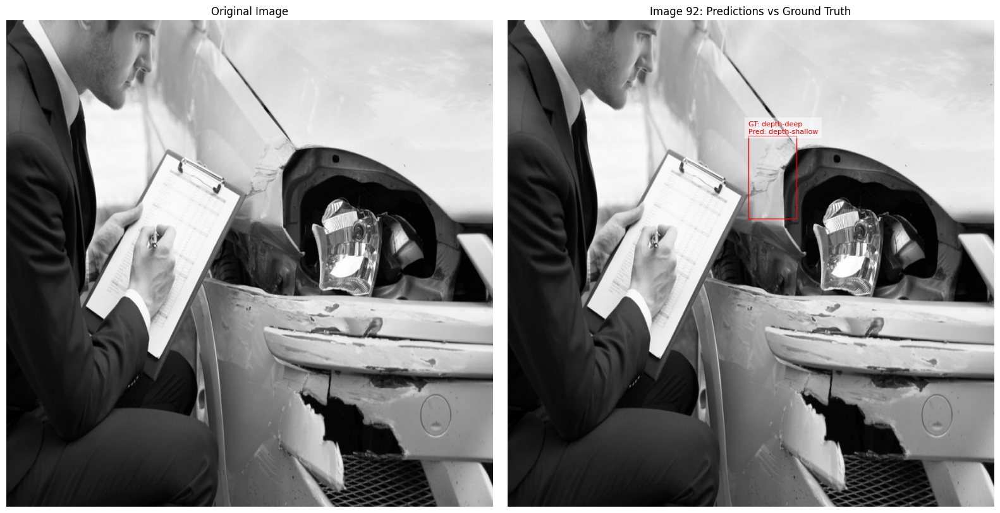

Visualizing predictions vs ground truth for image 75...
ROIs for image 74: [[45, 384, 451, 156], [508, 537, 201, 301]]
GT labels: ['depth-shallow', 'depth-shallow']
Predictions: [1, 1]


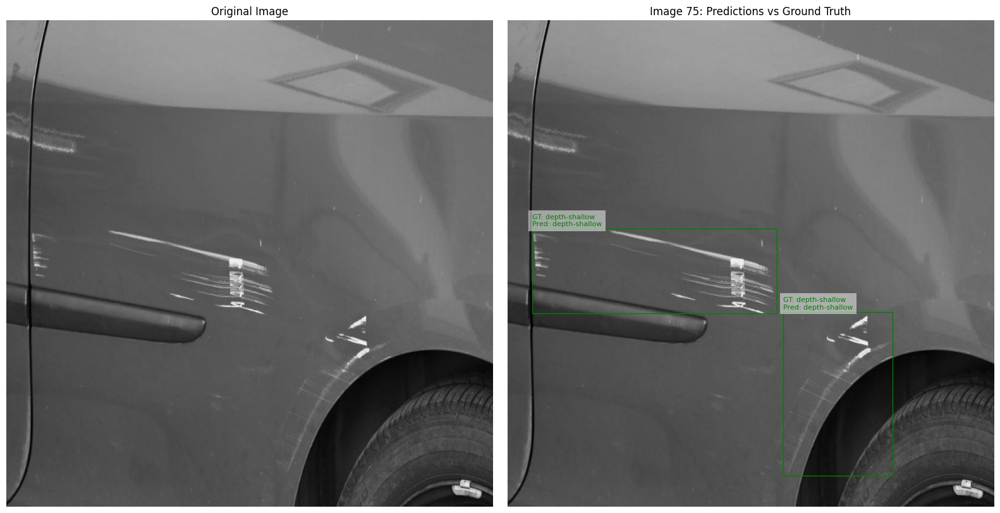


📋 GLCM Feature Summary by Class (from Evaluation Set):

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,510.6497,499.9817,543.7128,532.0615,482.1302,481.9356
1,455.9140,446.3853,482.2655,469.0330,423.4704,423.2076



📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.1834,2.1561,4.1027,4.0201,4.9282,4.6845
1,2.1882,2.1482,4.2986,4.0836,4.8258,4.6631



📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,335.5344,321.8922,328.9674,310.7782,279.8919,278.2331
1,335.7242,330.1214,345.1277,330.5434,293.6841,294.9848



📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.4470,-2.4573,-2.4583,-2.4598,-2.4660,-2.4640
1,-2.3516,-2.3732,-2.3289,-2.3607,-2.4749,-2.3806



📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,19557.8722,20574.2037,16487.1586,15024.4884,19798.2855,19701.5341
1,12885.6523,13292.9082,15146.1117,15422.3113,13193.7101,12381.7204



📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,1.3509,1.4498,1.1107,1.1311,0.7469,0.7082
1,1.6110,1.6624,1.3893,1.3858,1.0419,1.0477


In [20]:
accuracy, report, predictions = xgboost_model.evaluate(
    test_data['images'],
    test_data['rois'],
    test_data['labels']
)

# **Model Testing using Pre-Trained Model Weights**

If pre-trained model is available, verify if the **pre-trained model file (.txt)** and the **MLB file (.json)** is not broken or corrupted:

In [ ]:
from google.colab import files
import os
import json
import joblib
import lightgbm as lgb

def check_model_files(model_path, mlb_path):
    """Check if the trained model and MLB file are valid before loading."""

    # Verify model file existence
    if not os.path.exists(model_path):
        print(f"❌ Model file '{model_path}' does not exist!")
        return False

    try:
        # Load full LightGBM model using joblib
        model = joblib.load(model_path)

        if hasattr(model, "booster_"):
            booster = model.booster_
            print(f"✅ Model loaded successfully. Number of trees: {booster.num_trees()}")
        else:
            print("⚠️ Warning: Model does not appear to be trained.")
            return False

    except Exception as e:
        print(f"❌ Error loading model: {e}")
        return False

    # Verify MLB file existence
    if not os.path.exists(mlb_path):
        print(f"❌ MLB file '{mlb_path}' does not exist!")
        return False

    try:
        with open(mlb_path, 'r') as f:
            mlb_data = json.load(f)

        if "classes" in mlb_data and isinstance(mlb_data["classes"], list):
            print(f"✅ MLB file loaded successfully. Number of classes: {len(mlb_data['classes'])}")
        else:
            print("⚠️ Warning: MLB file structure is incorrect!")
            return False

    except json.JSONDecodeError:
        print("❌ Error: MLB file is not a valid JSON format!")
        return False
    except Exception as e:
        print(f"❌ Error loading MLB file: {e}")
        return False

    return True

# Upload model and MLB files
print("Upload the trained LightGBM model file (.txt)")
uploaded_model = files.upload()
model_path = next(iter(uploaded_model))

print("Upload the MLB file (.json)")
uploaded_mlb = files.upload()
mlb_path = next(iter(uploaded_mlb))

# Run validation check
is_valid = check_model_files(model_path, mlb_path)

if is_valid:
    print("✅ Both files are intact and ready for model loading!")
else:
    print("❌ One or both files may be broken or missing.")


Upload the trained LightGBM model file (.txt)


Saving xgboost.best_trained-glcm_model.txt to xgboost.best_trained-glcm_model (1).txt
Upload the MLB file (.json)


Saving xgboost_mlb.json to xgboost_mlb (1).json
⚠️ Warning: Model does not appear to be trained.
❌ One or both files may be broken or missing.


In [2]:
import sys
from pathlib import Path
import tensorflow as tf
import numpy as np
import sklearn
import pandas as pd
import matplotlib
import cv2
import scipy
from lightgbm import LGBMClassifier
from google.colab import files
import joblib

src_path = Path('/content/GLCM-Classifier/src')
if src_path.exists():
    sys.path.append(str(src_path))

from utils.data_loader import load_data
from config import Config
from glcm_model import GLCMModel

**Classifier types:**
- xgboost
- randomforest
- lightgbm

In [3]:
# Create a configuration object for the test set
config = Config(data_path="/content/GroupEGS-Thesis-Dataset", classifier_type="lightgbm")

# Load only the test data
data = load_data(config.data_path, include_labels=["depth-deep", "depth-shallow"])

# Extract the test set
test_data = data["test_data"]
print("Test data loaded successfully.")

# Display sample information about the test set
print("Sample ROIs:", test_data["rois"][:5])
print("Test Labels:", np.unique(test_data["labels"]))
print("Number of Test Images:", len(test_data["images"]))

Test data loaded successfully.
Sample ROIs: [[[0, 557, 521, 337], [486, 500, 86, 395], [600, 377, 86, 75], [611, 499, 43, 150], [713, 380, 36, 165]], [[427, 20, 394, 766]], [[439, 0, 230, 161], [491, 463, 105, 88], [730, 0, 165, 761]], [[247, 336, 73, 262]], [[247, 610, 88, 92], [330, 493, 108, 207], [208, 572, 53, 68]]]
Test Labels: [list(['depth-deep']) list(['depth-deep', 'depth-deep', 'depth-deep'])
 list(['depth-deep', 'depth-deep', 'depth-shallow'])
 list(['depth-deep', 'depth-deep', 'depth-shallow', 'depth-shallow', 'depth-deep'])
 list(['depth-shallow']) list(['depth-shallow', 'depth-shallow'])]
Number of Test Images: 13


/usr/local/lib/python3.11/dist-packages/numpy/lib/arraysetops.py:272: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ar = np.asanyarray(ar)


In [4]:
from google.colab import files
trained_model = GLCMModel(config)

# Upload the file
print("Upload the Pre-trained model file (.txt)")
uploaded = files.upload()  # User uploads the .txt model file
weights = next(iter(uploaded))

print("Upload the MLB file (.json)")
uploaded = files.upload()  # User uploads the .json MLB file
mlbfile = next(iter(uploaded))

print(f"Loaded model file: {weights}")
print(f"Loaded MLB file: {mlbfile}")

Using lightgbm as the classifier.
Upload the Pre-trained model file (.txt)


Saving xgboost.best_trained-glcm_model (4).txt to xgboost.best_trained-glcm_model (4).txt
Upload the MLB file (.json)


Saving xgboost_mlb (4).json to xgboost_mlb (4).json
Loaded model file: xgboost.best_trained-glcm_model (4).txt
Loaded MLB file: xgboost_mlb (4).json


In [5]:
trained_model.load_model(weights, mlbfile)

✅ Model loaded from xgboost.best_trained-glcm_model (4).txt
✅ MultiLabelBinarizer loaded from xgboost_mlb (4).json


## **Perform predictions with the pre-trained model**

Extracting GLCM features for the specified data...


Prediction Progress: 100%|██████████| 13/13 [01:33<00:00,  7.19s/it]


[Debug] Extracted input features shape: (24, 672)
[Debug] Total ROI predictions expected: 24

📷 Predictions for Image 10:
ROIs: [[128, 137, 183, 129]]
Predicted labels (numeric): [1]
Predicted labels (named): ['depth-shallow']


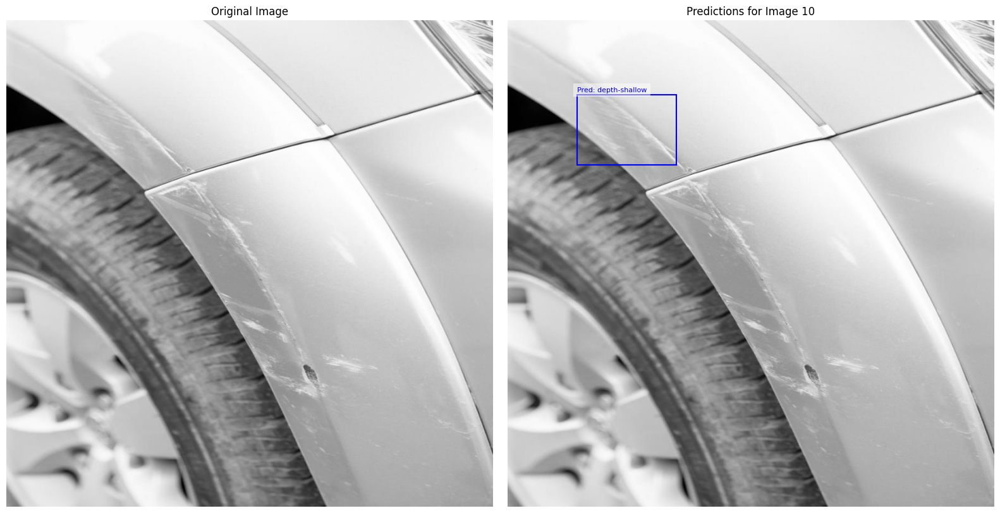

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[128, 137, 183, 129]",depth-shallow,562.5447,0.4017,7.492,0.2316,750.1265,3.3364



📷 Predictions for Image 11:
ROIs: [[472, 365, 60, 124]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


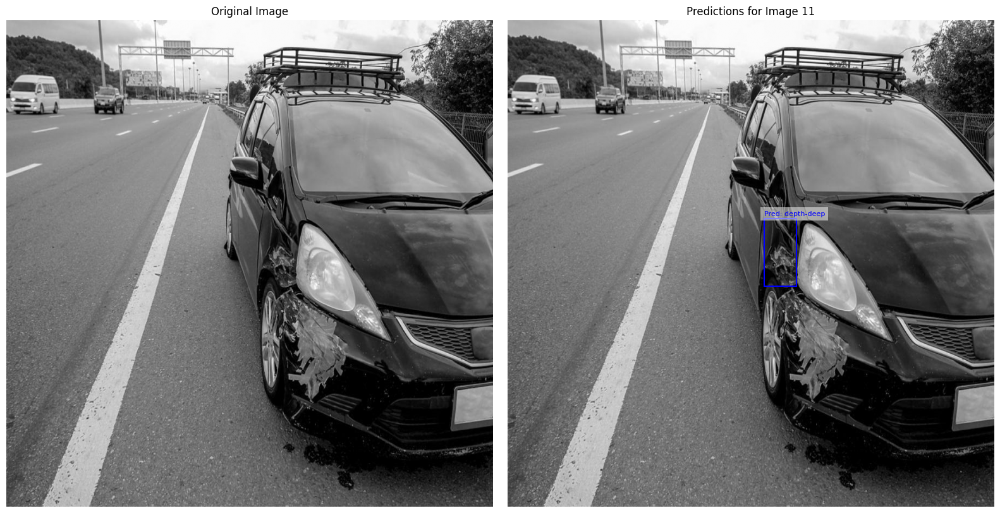

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[472, 365, 60, 124]",depth-deep,2690.3718,0.3091,7.3476,0.3678,1969.7031,4.5326



📷 Predictions for Image 2:
ROIs: [[427, 20, 394, 766]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


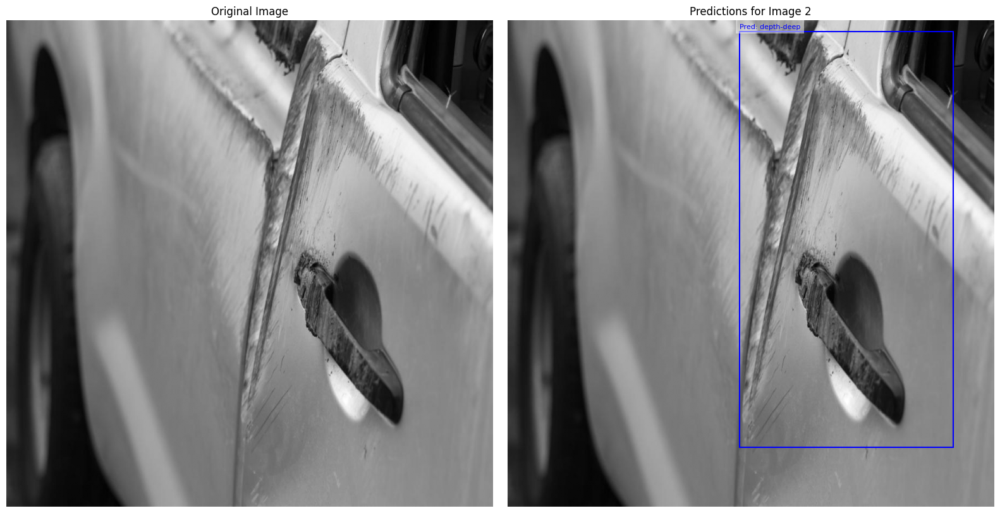

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[427, 20, 394, 766]",depth-deep,1655.2152,0.3407,8.952,0.3249,2417.1013,3.822



📷 Predictions for Image 9:
ROIs: [[479, 349, 248, 175], [637, 430, 147, 118]]
Predicted labels (numeric): [1, 1]
Predicted labels (named): ['depth-shallow', 'depth-shallow']


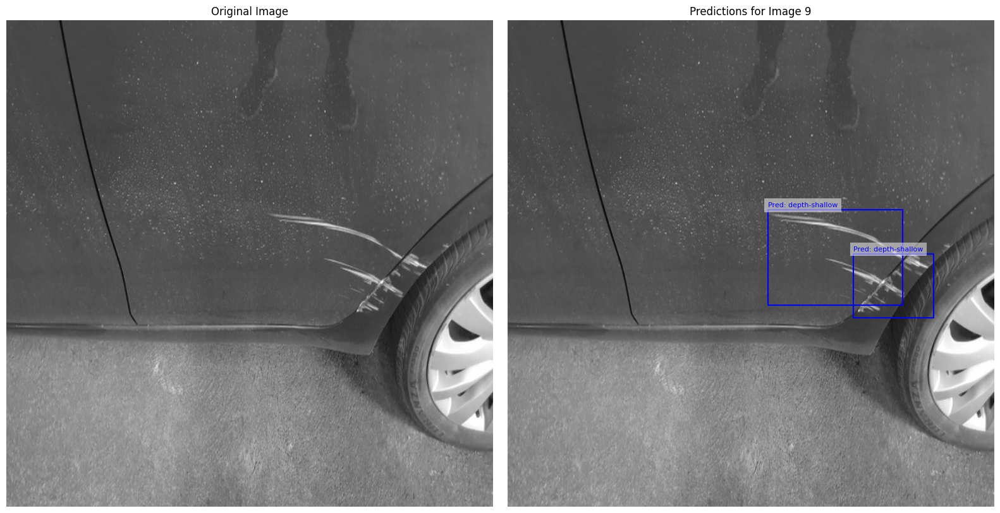

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[479, 349, 248, 175]",depth-shallow,909.7946,0.0519,7.9838,-0.0037,765.1725,3.8405
1,"[637, 430, 147, 118]",depth-shallow,1606.2270,0.1088,8.1340,0.1546,1337.2240,4.3299



📷 Predictions for Image 3:
ROIs: [[439, 0, 230, 161], [491, 463, 105, 88], [730, 0, 165, 761]]
Predicted labels (numeric): [0, 1, 0]
Predicted labels (named): ['depth-deep', 'depth-shallow', 'depth-deep']


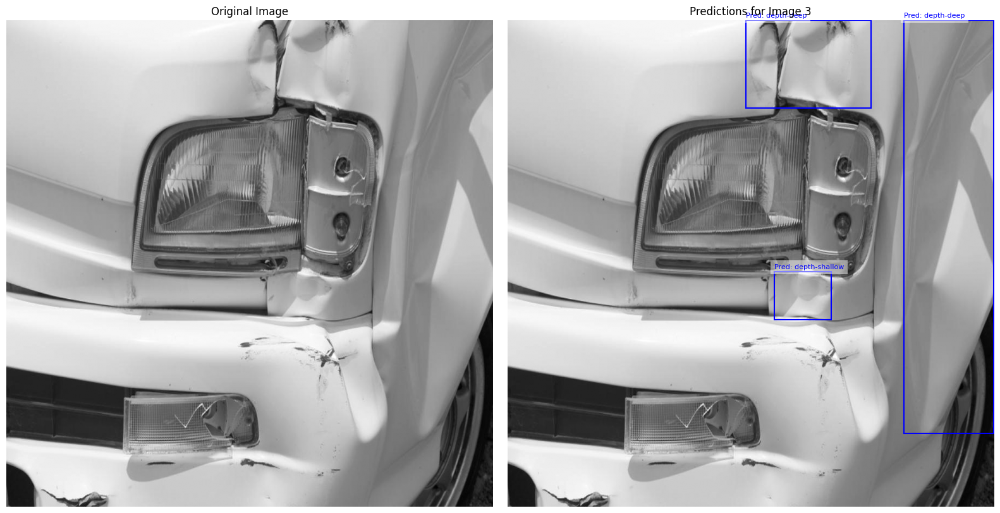

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[439, 0, 230, 161]",depth-deep,1085.4978,0.2061,8.1998,0.2315,1302.975,3.7473
1,"[491, 463, 105, 88]",depth-shallow,978.6040,0.2188,7.0969,0.1619,864.007,3.8296
2,"[730, 0, 165, 761]",depth-deep,584.2105,0.1926,7.6303,0.1326,1327.963,3.1582


[Debug] GLCM Features Shape: (24, 672)
[Debug] Number of Labels: 24

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,492.6189,487.7626,539.2796,527.0758,471.7976,465.5223
1,539.0213,521.2866,560.1487,531.8175,469.7826,474.6253


💾 Saved Mean stats to GLCM_Stats_mean.csv

📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.1243,2.1018,4.2781,4.1235,4.7986,4.3971
1,2.7136,2.5924,5.0165,4.7723,5.4718,5.2825


💾 Saved Median stats to GLCM_Stats_median.csv

📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,313.9333,305.7867,313.4313,297.8941,276.6464,271.1815
1,310.3000,306.1302,320.0704,292.8704,264.7491,253.8627


💾 Saved Std stats to GLCM_Stats_std.csv

📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.1983,-2.3287,-2.2002,-2.3474,-2.3148,-2.1933
1,-2.3258,-2.3675,-2.3317,-2.3586,-2.3755,-2.3778


💾 Saved Min stats to GLCM_Stats_min.csv

📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,8181.3506,8488.7702,9778.5659,9393.0858,10271.8351,9029.7691
1,9257.1410,8097.2753,9145.9713,9198.8170,8302.4547,8257.5850


💾 Saved Max stats to GLCM_Stats_max.csv

📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,0.5044,0.4748,0.5008,0.5248,0.4483,0.3971
1,0.4886,0.4871,0.4103,0.4436,0.3870,0.3711


💾 Saved Skew stats to GLCM_Stats_skew.csv


{'Mean':         contrast  homogeneity     entropy    max_prob    variance  \
 Class                                                               
 0      492.61892   487.762636  539.279568  527.075759  471.797646   
 1      539.02125   521.286632  560.148740  531.817450  469.782644   
 
        diff_entropy  
 Class                
 0        465.522283  
 1        474.625338  ,
 'Median':        contrast  homogeneity   entropy  max_prob  variance  diff_entropy
 Class                                                                   
 0      2.124288     2.101784  4.278110  4.123472  4.798553      4.397101
 1      2.713639     2.592445  5.016492  4.772341  5.471771      5.282506,
 'Std':          contrast  homogeneity     entropy    max_prob    variance  \
 Class                                                                
 0      313.933308   305.786678  313.431283  297.894102  276.646386   
 1      310.299991   306.130230  320.070425  292.870411  264.749085   
 
        diff_entr

In [6]:
# Run prediction
trained_model_prediction_result = trained_model.predict(test_data["images"], test_data["rois"])

features = trained_model_prediction_result["features"]
labels = np.concatenate(trained_model_prediction_result["predictions"])

print(f"[Debug] GLCM Features Shape: {features.shape}")
print(f"[Debug] Number of Labels: {len(labels)}")

trained_model.create_feature_summary_tables(features, labels, save_to_csv=True)

## **Evaluate the pre-trained model**

Extracting GLCM features for the specified data...


Prediction Progress: 100%|██████████| 13/13 [01:19<00:00,  6.10s/it]


[Debug] Extracted input features shape: (24, 672)
[Debug] Total ROI predictions expected: 24

📷 Predictions for Image 4:
ROIs: [[247, 336, 73, 262]]
Predicted labels (numeric): [1]
Predicted labels (named): ['depth-shallow']


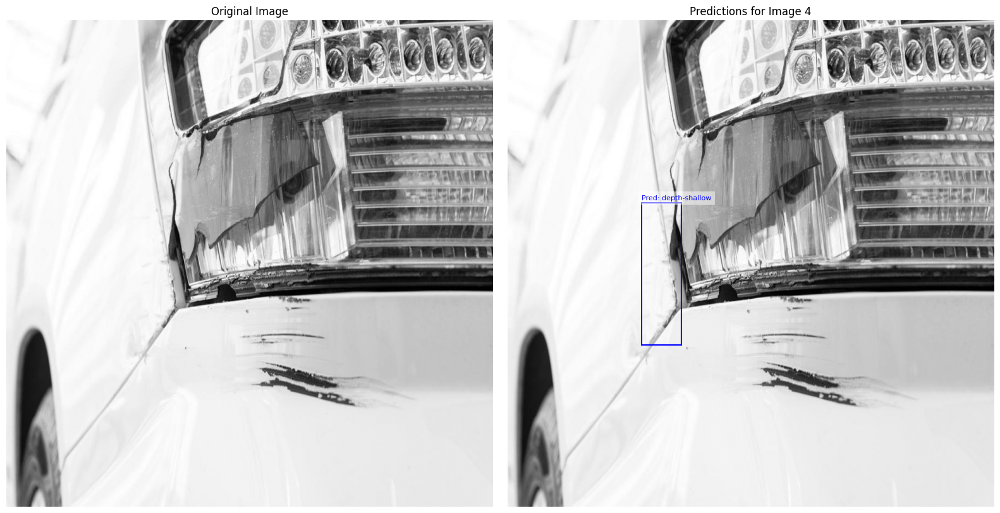

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[247, 336, 73, 262]",depth-shallow,1315.2196,0.2801,7.1697,0.241,1835.8887,3.7053



📷 Predictions for Image 7:
ROIs: [[77, 131, 374, 66]]
Predicted labels (numeric): [1]
Predicted labels (named): ['depth-shallow']


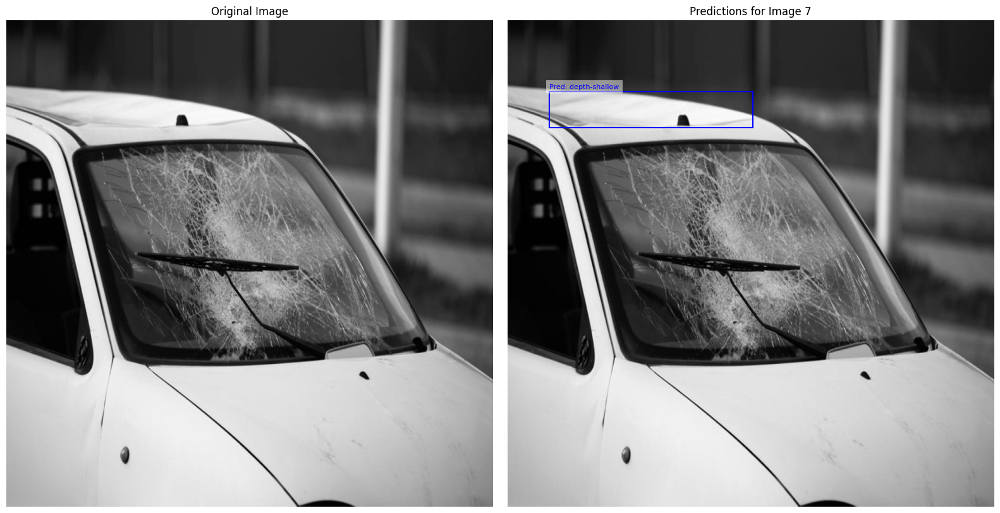

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[77, 131, 374, 66]",depth-shallow,965.3293,0.2005,7.6873,0.1232,2286.0547,3.6037



📷 Predictions for Image 2:
ROIs: [[427, 20, 394, 766]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


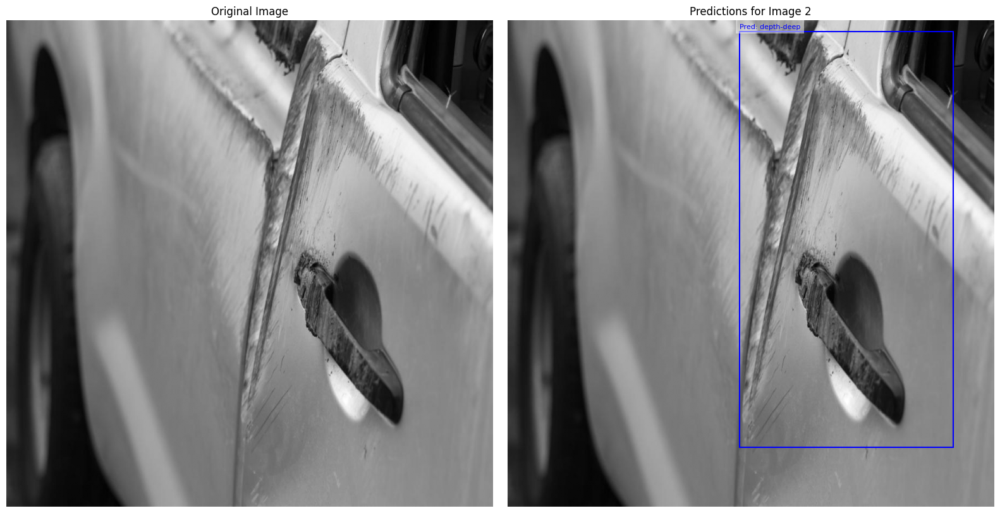

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[427, 20, 394, 766]",depth-deep,1655.2152,0.3407,8.952,0.3249,2417.1013,3.822



📷 Predictions for Image 11:
ROIs: [[472, 365, 60, 124]]
Predicted labels (numeric): [0]
Predicted labels (named): ['depth-deep']


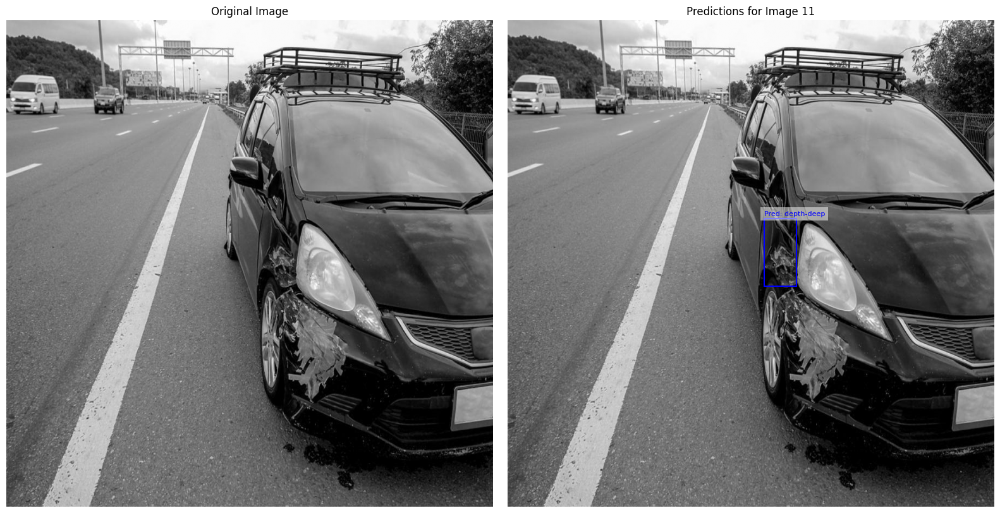

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[472, 365, 60, 124]",depth-deep,2690.3718,0.3091,7.3476,0.3678,1969.7031,4.5326



📷 Predictions for Image 1:
ROIs: [[0, 557, 521, 337], [486, 500, 86, 395], [600, 377, 86, 75], [611, 499, 43, 150], [713, 380, 36, 165]]
Predicted labels (numeric): [0, 0, 1, 1, 1]
Predicted labels (named): ['depth-deep', 'depth-deep', 'depth-shallow', 'depth-shallow', 'depth-shallow']


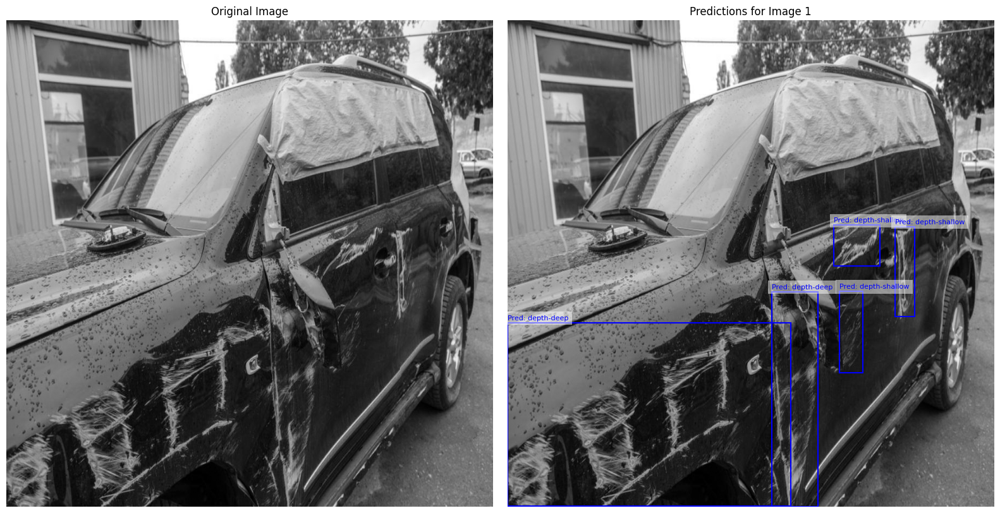

📋 GLCM Feature Summary Table:


,ROI,Predicted Label,contrast_mean,homogeneity_mean,entropy_mean,max_prob_mean,variance_mean,diff_entropy_mean
0,"[0, 557, 521, 337]",depth-deep,2281.2544,0.2473,9.2496,0.3524,2445.2797,4.3327
1,"[486, 500, 86, 395]",depth-deep,1968.3102,0.0559,8.8638,0.0484,1991.0292,4.5601
2,"[600, 377, 86, 75]",depth-shallow,3175.6312,0.0643,7.4013,0.0941,2259.3606,4.6155
3,"[611, 499, 43, 150]",depth-shallow,2246.9638,0.1752,7.2619,0.1765,1643.2860,4.3774
4,"[713, 380, 36, 165]",depth-shallow,3001.1058,0.0475,7.5220,-0.0216,2173.0389,4.7257


Test Accuracy: 0.88
Classification Report:
                precision    recall  f1-score   support

   depth-deep       1.00      0.80      0.89        15
depth-shallow       0.75      1.00      0.86         9

     accuracy                           0.88        24
    macro avg       0.88      0.90      0.87        24
 weighted avg       0.91      0.88      0.88        24


Confusion Matrix:


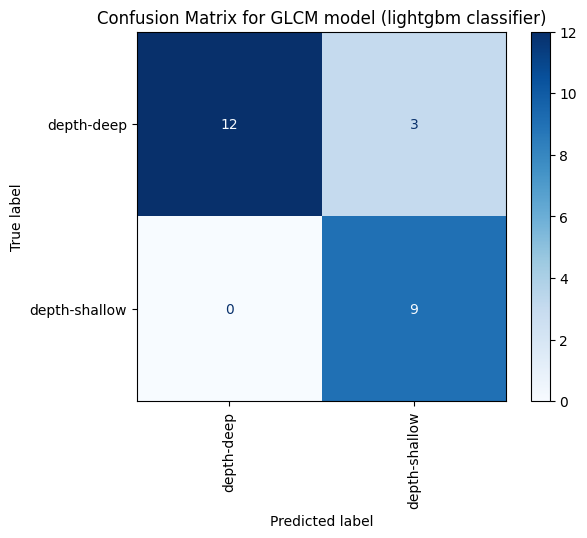

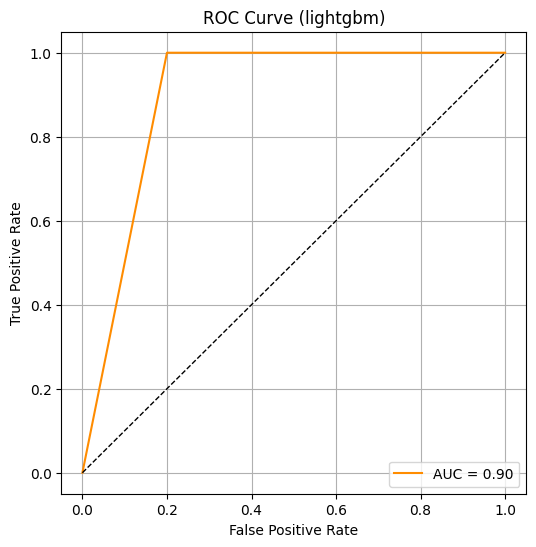

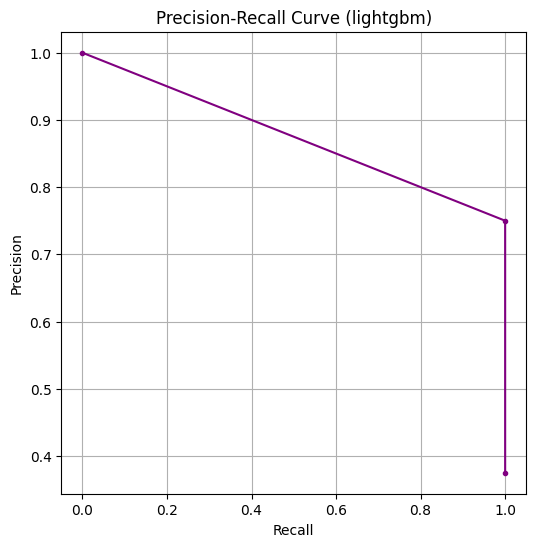

Mean Average Precision (mAP): 0.75


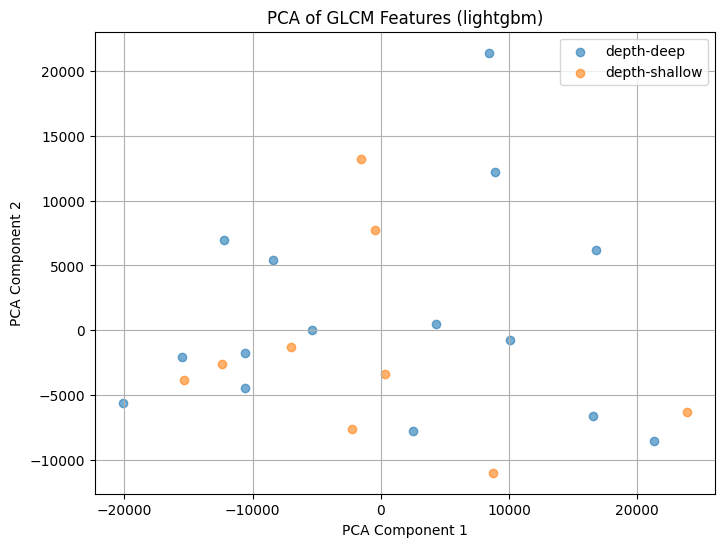

Visualizing predictions vs ground truth for image 10...
ROIs for image 9: [[128, 137, 183, 129]]
GT labels: ['depth-shallow']
Predictions: [1]


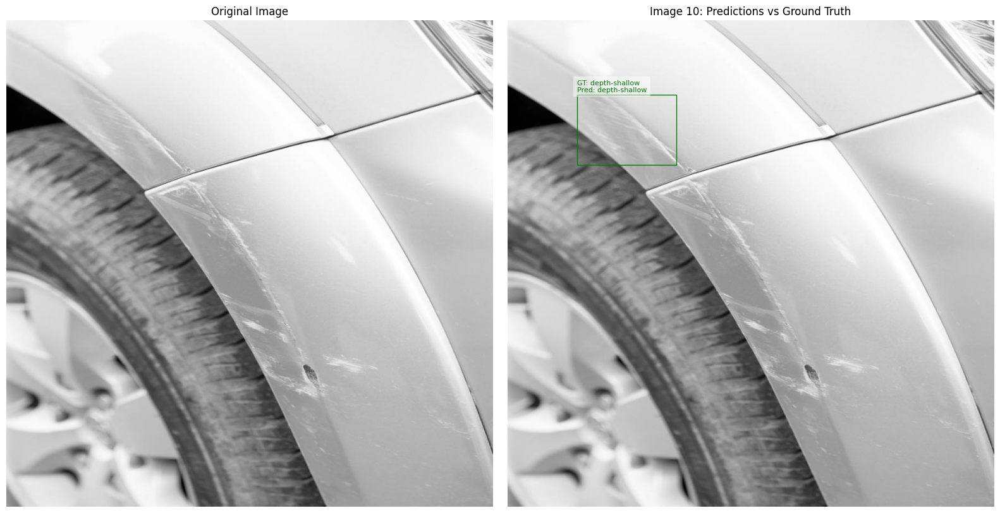

Visualizing predictions vs ground truth for image 2...
ROIs for image 1: [[427, 20, 394, 766]]
GT labels: ['depth-deep']
Predictions: [0]


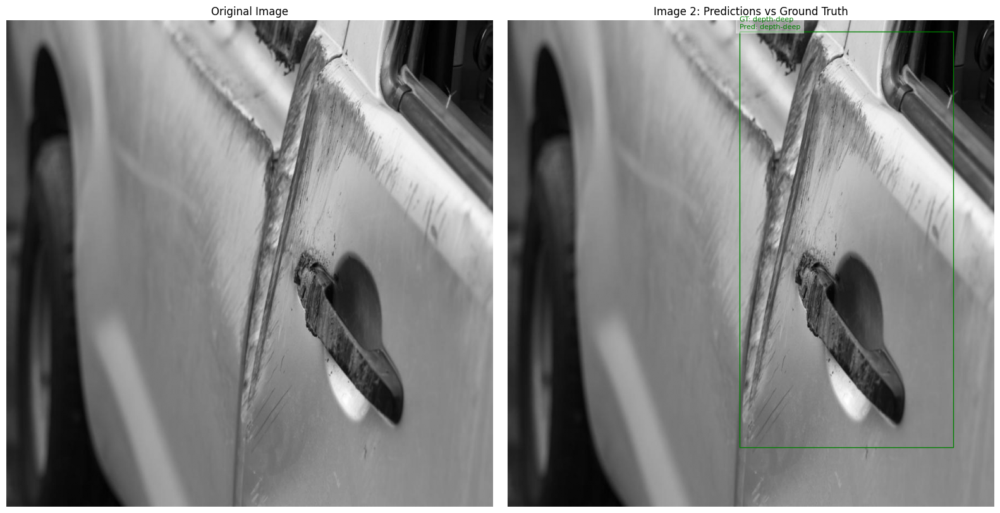

Visualizing predictions vs ground truth for image 11...
ROIs for image 10: [[472, 365, 60, 124]]
GT labels: ['depth-deep']
Predictions: [0]


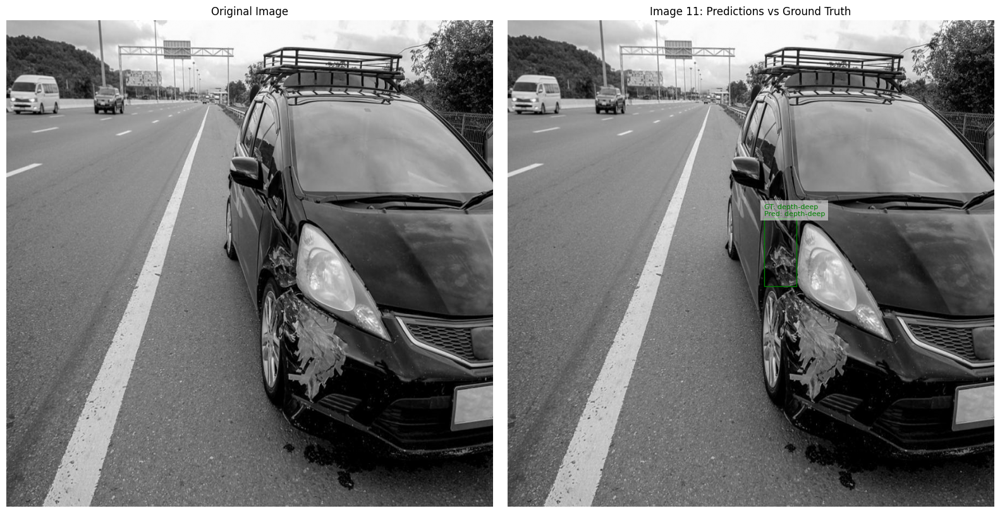

Visualizing predictions vs ground truth for image 6...
ROIs for image 5: [[195, 211, 422, 450]]
GT labels: ['depth-deep']
Predictions: [0]


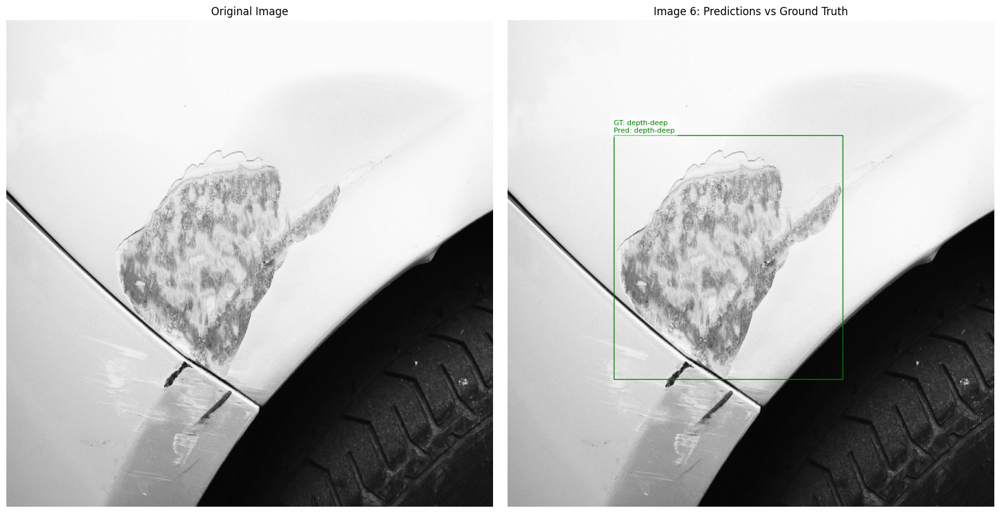

Visualizing predictions vs ground truth for image 9...
ROIs for image 8: [[479, 349, 248, 175], [637, 430, 147, 118]]
GT labels: ['depth-shallow', 'depth-shallow']
Predictions: [1, 1]


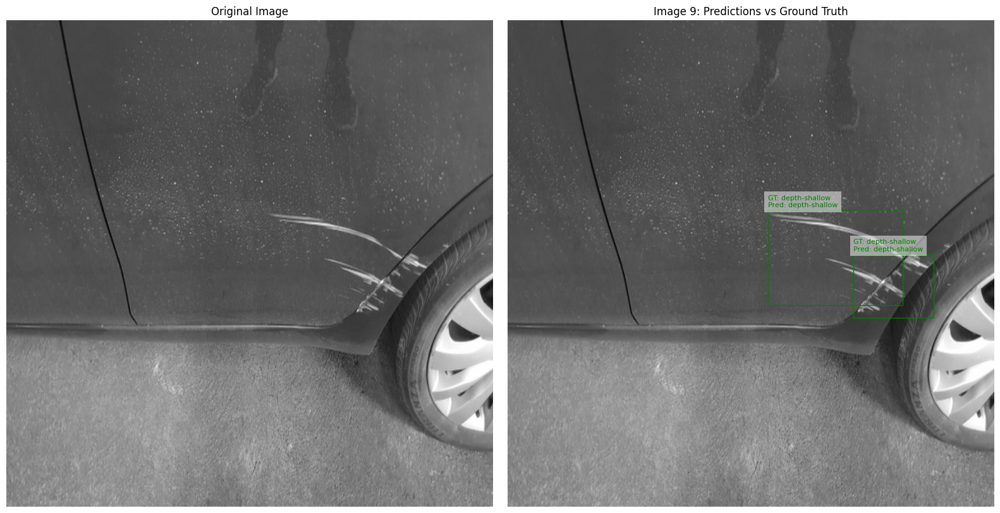


📋 GLCM Feature Summary by Class (from Evaluation Set):

📊 GLCM Feature Mean by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,514.7862,508.4603,559.9347,539.3325,479.8998,474.0528
1,517.5433,497.9653,532.6800,512.9701,455.6073,463.4421



📊 GLCM Feature Median by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,2.2715,2.1904,4.3994,4.3514,4.9961,4.7611
1,2.4291,2.2870,4.6927,4.4024,4.8062,4.6444



📊 GLCM Feature Std by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,330.4062,327.1072,331.3656,305.3306,280.5537,273.3596
1,305.3434,297.3567,315.2927,295.1657,269.8900,259.9615



📊 GLCM Feature Min by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,-2.1983,-2.3287,-2.2002,-2.3474,-2.3148,-2.1933
1,-2.3258,-2.3675,-2.3317,-2.3586,-2.3755,-2.3778



📊 GLCM Feature Max by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,8181.3506,8488.7702,9778.5659,9393.0858,10271.8351,9029.7691
1,9257.1410,8097.2753,9145.9713,9198.8170,7901.7976,8257.5850



📊 GLCM Feature Skew by Depth Class:


,contrast,homogeneity,entropy,max_prob,variance,diff_entropy
Class,,,,,,
0,0.5554,0.5823,0.5845,0.6151,0.5537,0.4865
1,0.4451,0.4218,0.3664,0.3933,0.3187,0.2980


In [7]:
accuracy, report, predictions = trained_model.evaluate(
    test_data['images'],
    test_data['rois'],
    test_data['labels']
)